# **1.DATA PREPARATION**

In [ ]:
# Install dependencies as needed:
# pip install kagglehub[pandas-datasets]
import kagglehub
from kagglehub import KaggleDatasetAdapter

# Set the path to the file you'd like to load
file_path = "transactions.csv"

# Load the latest version
df = kagglehub.load_dataset(
  KaggleDatasetAdapter.PANDAS,
  "ricgomes/global-fashion-retail-stores-dataset",
  file_path,
  # Provide any additional arguments like
  # sql_query or pandas_kwargs. See the
  # documenation for more information:
  # https://github.com/Kaggle/kagglehub/blob/main/README.md#kaggledatasetadapterpandas
)

print("First 5 records:", df.head())

/tmp/ipython-input-70037005.py:10: DeprecationWarning: load_dataset is deprecated and will be removed in a future version.
  df = kagglehub.load_dataset(


First 5 records:             Invoice ID  Line  Customer ID  Product ID Size    Color  \
0  INV-US-001-03558761     1        47162         485    M      NaN   
1  INV-US-001-03558761     2        47162        2779    G      NaN   
2  INV-US-001-03558761     3        47162          64    M  NEUTRAL   
3  INV-US-001-03558762     1        10142         131    M     BLUE   
4  INV-US-001-03558762     2        10142         716    L    WHITE   

   Unit Price  Quantity                 Date  Discount  Line Total  Store ID  \
0        80.5         1  2023-01-01 15:42:00       0.0        80.5         1   
1        31.5         1  2023-01-01 15:42:00       0.4        18.9         1   
2        45.5         1  2023-01-01 15:42:00       0.4        27.3         1   
3        70.0         1  2023-01-01 20:04:00       0.4        42.0         1   
4        26.0         1  2023-01-01 20:04:00       0.0        26.0         1   

   Employee ID Currency Currency Symbol               SKU Transaction Type 

In [ ]:
!pip install ydata-profiling

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.0/62.0 kB 2.2 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 400.1/400.1 kB 11.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 17.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.8/3.8 MB 76.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 679.0/679.0 kB 36.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 37.7/37.7 MB 40.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.5/10.5 MB 119.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 105.4/105.4 kB 7.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 547.9/547.9 kB 33.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 232.9/232.9 kB 15.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.3/43.3 kB 3.1 MB/

In [ ]:
from ydata_profiling import ProfileReport
# Giả sử bạn đã có DataFrame df
profile = ProfileReport(df, title="EDA Report", explorative=True)

# Xem báo cáo trực tiếp trong notebook (nếu bạn dùng Jupyter)
profile.to_notebook_iframe()

# Hoặc lưu ra HTML
profile.to_file("eda_report.html")



1. Duplicate Rows
2. 1 Invoice có nhiều line
3. Chỉ có 20% Distinct Customers; còn 80% repeat behaviours.
4. Null Size; Color --> không quan trọng
5. Dữ liệu > 2 năm
6. Transaction TYpe có Return
7. Có Total âm



In [ ]:
df_returned_order = df[df['Transaction Type'] == "Return"]

In [ ]:
from ydata_profiling import ProfileReport
# Giả sử bạn đã có DataFrame df
profile_df_returned_order = ProfileReport(df_returned_order, title="EDA Report", explorative=True)

# Xem báo cáo trực tiếp trong notebook (nếu bạn dùng Jupyter)
profile_df_returned_order.to_notebook_iframe()

# Hoặc lưu ra HTML
profile_df_returned_order.to_file("df_returned_order.html")


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████| 19/19 [00:28<00:00,  1.50s/it]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
df_completed_order = df[df['Transaction Type'] != "Return"]

In [ ]:
from ydata_profiling import ProfileReport
# Giả sử bạn đã có DataFrame df
profile_df_completed_order = ProfileReport(df_completed_order, title="EDA Report", explorative=True)

# Xem báo cáo trực tiếp trong notebook (nếu bạn dùng Jupyter)
profile_df_completed_order.to_notebook_iframe()

# Hoặc lưu ra HTML
profile_df_completed_order.to_file("df_completed_order.html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████| 19/19 [04:48<00:00, 15.20s/it]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
df_completed_order

,Invoice ID,Line,Customer ID,Product ID,Size,Color,Unit Price,Quantity,Date,Discount,Line Total,Store ID,Employee ID,Currency,Currency Symbol,SKU,Transaction Type,Payment Method,Invoice Total
0,INV-US-001-03558761,1,47162,485,M,NaN,80.5,1,2023-01-01 15:42:00,0.00,80.50,1,7,USD,$,MASU485-M-,Sale,Cash,126.70
1,INV-US-001-03558761,2,47162,2779,G,NaN,31.5,1,2023-01-01 15:42:00,0.40,18.90,1,7,USD,$,CHCO2779-G-,Sale,Cash,126.70
2,INV-US-001-03558761,3,47162,64,M,NEUTRAL,45.5,1,2023-01-01 15:42:00,0.40,27.30,1,7,USD,$,MACO64-M-NEUTRAL,Sale,Cash,126.70
3,INV-US-001-03558762,1,10142,131,M,BLUE,70.0,1,2023-01-01 20:04:00,0.40,42.00,1,6,USD,$,FECO131-M-BLUE,Sale,Cash,77.00
4,INV-US-001-03558762,2,10142,716,L,WHITE,26.0,1,2023-01-01 20:04:00,0.00,26.00,1,6,USD,$,MAT-716-L-WHITE,Sale,Cash,77.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6416822,INV-PT-035-01497756,2,1640168,15414,P,NaN,35.5,1,2025-03-18 08:52:00,0.35,23.07,35,402,EUR,€,CHGI15414-P-,Sale,Credit Card,69.55
6416823,INV-PT-035-01497756,3,1640168,15232,G,RED,51.5,1,2025-03-18 08:52:00,0.35,33.48,35,402,EUR,€,CHGI15232-G-RED,Sale,Credit Card,69.55
6416824,INV-PT-035-01497757,1,1636770,15401,XL,NaN,40.0,1,2025-03-18 19:01:00,0.00,40.00,35,404,EUR,€,FESP15401-XL-,Sale,Credit Card,40.00
6416825,INV-PT-035-01497758,1,1642472,15671,M,NaN,36.5,1,2025-03-18 19:10:00,0.00,36.50,35,399,EUR,€,MAUN15671-M-,Sale,Credit Card,36.50


In [ ]:
# Install dependencies as needed:
# pip install kagglehub[pandas-datasets]
import kagglehub
from kagglehub import KaggleDatasetAdapter

# Set the path to the file you'd like to load
file_path = "customers.csv"

# Load the latest version
customers_df = kagglehub.load_dataset(
  KaggleDatasetAdapter.PANDAS,
  "ricgomes/global-fashion-retail-stores-dataset",
  file_path,
  # Provide any additional arguments like
  # sql_query or pandas_kwargs. See the
  # documenation for more information:
  # https://github.com/Kaggle/kagglehub/blob/main/README.md#kaggledatasetadapterpandas
)

print("First 5 records:", customers_df.head())

/tmp/ipython-input-1499029122.py:10: DeprecationWarning: load_dataset is deprecated and will be removed in a future version.
  customers_df = kagglehub.load_dataset(


First 5 records:    Customer ID                 Name                                 Email  \
0            1         Tyler Garcia           tyler.garcia@fake_gmail.com   
1            2        Joshua Miller          joshua.miller@fake_gmail.com   
2            3  Alison Marshall DDS  alison.marshall.dds@fake_hotmail.com   
3            4       Jeffery Acosta         jeffery.acosta@fake_yahoo.com   
4            5       Ashley Sanders       ashley.sanders@fake_hotmail.com   

              Telephone      City        Country Gender Date Of Birth  \
0    922.970.2265x47563  New York  United States      M    2003-07-15   
1       +1-958-729-6169  New York  United States      M    2000-06-16   
2  +1-645-567-0876x5409  New York  United States      F    2003-07-22   
3    212.336.0912x84994  New York  United States      M    1996-11-12   
4            7814535781  New York  United States      F    1998-02-10   

               Job Title  
0                    NaN  
1        Records manager  


/usr/local/lib/python3.11/dist-packages/kagglehub/pandas_datasets.py:91: DtypeWarning: Columns (3) have mixed types. Specify dtype option on import or set low_memory=False.
  result = read_function(


In [ ]:
customers_df

,Customer ID,Name,Email,Telephone,City,Country,Gender,Date Of Birth,Job Title
0,1,Tyler Garcia,tyler.garcia@fake_gmail.com,922.970.2265x47563,New York,United States,M,2003-07-15,NaN
1,2,Joshua Miller,joshua.miller@fake_gmail.com,+1-958-729-6169,New York,United States,M,2000-06-16,Records manager
2,3,Alison Marshall DDS,alison.marshall.dds@fake_hotmail.com,+1-645-567-0876x5409,New York,United States,F,2003-07-22,NaN
3,4,Jeffery Acosta,jeffery.acosta@fake_yahoo.com,212.336.0912x84994,New York,United States,M,1996-11-12,Proofreader
4,5,Ashley Sanders,ashley.sanders@fake_hotmail.com,7814535781,New York,United States,F,1998-02-10,Exercise physiologist
...,...,...,...,...,...,...,...,...,...
1643301,1643302,Bernardo Vicente,bernardo.vicente@fake_hotmail.com,(351) 962314916,Arruda dos Vinhos,Portugal,M,1973-02-27,Structural engineer
1643302,1643303,Luana Leite,luana.leite@fake_clix.pt,(351) 288 728 807,Arruda dos Vinhos,Portugal,F,1997-02-05,Futures trader
1643303,1643304,Ema Freitas,ema.freitas@fake_clix.pt,+351910990620,Arruda dos Vinhos,Portugal,F,2005-03-14,NaN
1643304,1643305,Rafaela Carneiro,rafaela.carneiro@fake_clix.pt,+351938182129,Arruda dos Vinhos,Portugal,F,1989-07-14,Futures trader


In [ ]:
import pandas as pd
joined_df= pd.merge(df_completed_order, customers_df[['Customer ID', 'City','Country']], on='Customer ID', how='left')

In [ ]:
joined_df

,Invoice ID,Line,Customer ID,Product ID,Size,Color,Unit Price,Quantity,Date,Discount,...,Store ID,Employee ID,Currency,Currency Symbol,SKU,Transaction Type,Payment Method,Invoice Total,City,Country
0,INV-US-001-03558761,1,47162,485,M,NaN,80.5,1,2023-01-01 15:42:00,0.00,...,1,7,USD,$,MASU485-M-,Sale,Cash,126.70,New York,United States
1,INV-US-001-03558761,2,47162,2779,G,NaN,31.5,1,2023-01-01 15:42:00,0.40,...,1,7,USD,$,CHCO2779-G-,Sale,Cash,126.70,New York,United States
2,INV-US-001-03558761,3,47162,64,M,NEUTRAL,45.5,1,2023-01-01 15:42:00,0.40,...,1,7,USD,$,MACO64-M-NEUTRAL,Sale,Cash,126.70,New York,United States
3,INV-US-001-03558762,1,10142,131,M,BLUE,70.0,1,2023-01-01 20:04:00,0.40,...,1,6,USD,$,FECO131-M-BLUE,Sale,Cash,77.00,New York,United States
4,INV-US-001-03558762,2,10142,716,L,WHITE,26.0,1,2023-01-01 20:04:00,0.00,...,1,6,USD,$,MAT-716-L-WHITE,Sale,Cash,77.00,New York,United States
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6077195,INV-PT-035-01497756,2,1640168,15414,P,NaN,35.5,1,2025-03-18 08:52:00,0.35,...,35,402,EUR,€,CHGI15414-P-,Sale,Credit Card,69.55,Coimbra,Portugal
6077196,INV-PT-035-01497756,3,1640168,15232,G,RED,51.5,1,2025-03-18 08:52:00,0.35,...,35,402,EUR,€,CHGI15232-G-RED,Sale,Credit Card,69.55,Coimbra,Portugal
6077197,INV-PT-035-01497757,1,1636770,15401,XL,NaN,40.0,1,2025-03-18 19:01:00,0.00,...,35,404,EUR,€,FESP15401-XL-,Sale,Credit Card,40.00,Coimbra,Portugal
6077198,INV-PT-035-01497758,1,1642472,15671,M,NaN,36.5,1,2025-03-18 19:10:00,0.00,...,35,399,EUR,€,MAUN15671-M-,Sale,Credit Card,36.50,Cantanhede,Portugal


In [ ]:
# Đếm số lượng khách hàng duy nhất theo từng City và Country
customer_count = joined_df.groupby([ 'Country'])['Customer ID'].nunique().reset_index()

# Đổi tên cột cho rõ ràng
customer_count.columns = ['City', 'Unique Customers']

# Hiển thị kết quả
print(customer_count)


             City  Unique Customers
0     Deutschland            160513
1          España            146990
2          France            149194
3        Portugal            100379
4  United Kingdom            140800
5   United States            298711
6              中国            287120


In [ ]:
fr_df = joined_df[(joined_df["Country"] == "France")]

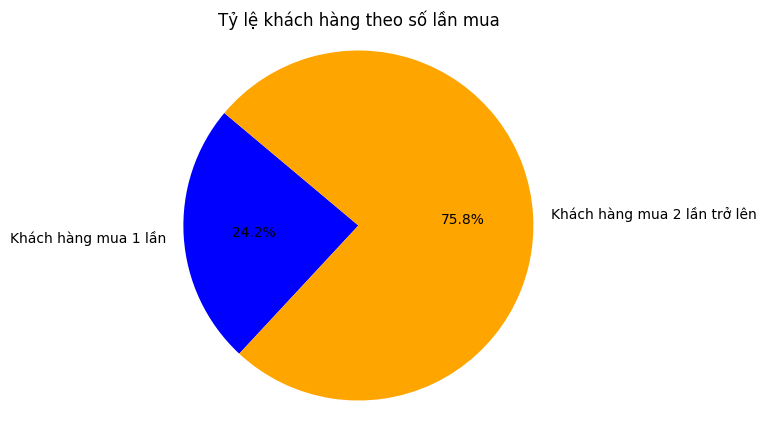

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Tính số lần mua của mỗi khách hàng
order_count = fr_df['Customer ID'].value_counts()

# Đếm số khách hàng mua 1 lần và 2 lần trở lên
num_one_time_customers = (order_count == 1).sum()
num_multiple_time_customers = (order_count > 1).sum()

# Dữ liệu cho biểu đồ
labels = ['Khách hàng mua 1 lần', 'Khách hàng mua 2 lần trở lên']
sizes = [num_one_time_customers, num_multiple_time_customers]

# Vẽ biểu đồ tròn
plt.figure(figsize=(8, 5))
plt.pie(sizes, labels=labels, colors=['blue', 'orange'], autopct='%1.1f%%', startangle=140)
plt.title('Tỷ lệ khách hàng theo số lần mua')
plt.axis('equal')  # Đảm bảo biểu đồ tròn
plt.show()

In [ ]:
!pip install pymc_marketing

  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 295.6/295.6 kB 7.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 40.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 517.6/517.6 kB 33.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 535.5/535.5 kB 32.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 68.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 67.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 108.8/108.8 kB 8.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.5/50.5 kB 3.4 MB/s eta 0:00:00
  Created wheel for logical-unification: filename=logical_unification-0.4.6-py3-none-any.whl size=14007 sha256=3c84075c181fa45bccc978b94238ee7e76748db9391b3d16315b944745cd476f
  Stored in directory: /root/.cache/pip/wheels/b8/34/a9/c1

## 1.1. Level 1 Variables

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import plotly.express as px
import arviz as az
import pymc as pm
from arviz.labels import MapLabeller
from IPython.display import Image
from pymc_marketing import clv
from scipy.special import expit, hyp2f1
import pytensor.tensor as pt

az.style.use("arviz-darkgrid")
plt.rcParams["figure.figsize"] = [12, 7]
plt.rcParams["figure.dpi"] = 100
plt.rcParams["figure.facecolor"] = "white"

seed = sum(map(ord, "juanitorduz"))
rng = np.random.default_rng(seed)

%load_ext autoreload
%autoreload 2
%config InlineBackend.figure_format = "retina"

In [ ]:
fr_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 615022 entries, 906 to 6073608
Data columns (total 21 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   Invoice ID        615022 non-null  object 
 1   Line              615022 non-null  int64  
 2   Customer ID       615022 non-null  int64  
 3   Product ID        615022 non-null  int64  
 4   Size              575539 non-null  object 
 5   Color             195046 non-null  object 
 6   Unit Price        615022 non-null  float64
 7   Quantity          615022 non-null  int64  
 8   Date              615022 non-null  object 
 9   Discount          615022 non-null  float64
 10  Line Total        615022 non-null  float64
 11  Store ID          615022 non-null  int64  
 12  Employee ID       615022 non-null  int64  
 13  Currency          615022 non-null  object 
 14  Currency Symbol   615022 non-null  object 
 15  SKU               615022 non-null  object 
 16  Transaction Type  6150

In [ ]:
fr_df['Date'] = pd.to_datetime(fr_df['Date'])

/tmp/ipython-input-2746560612.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fr_df['Date'] = pd.to_datetime(fr_df['Date'])


In [ ]:
fr_df

,Invoice ID,Line,Customer ID,Product ID,Size,Color,Unit Price,Quantity,Date,Discount,...,Store ID,Employee ID,Currency,Currency Symbol,SKU,Transaction Type,Payment Method,Invoice Total,City,Country
906,INV-US-001-03559419,1,1222194,396,36,NaN,45.50,1,2023-01-01 13:02:00,0.0,...,1,11,USD,$,FEPA396-36-,Sale,Credit Card,45.50,Toulouse,France
1710,INV-US-001-03559981,1,1256394,1821,S,NEUTRAL,32.00,1,2023-01-01 20:31:00,0.4,...,1,6,USD,$,FECO1821-S-NEUTRAL,Sale,Credit Card,19.20,Antibes,France
2242,INV-US-001-03560380,1,1243390,2560,XXL,BEIGE,36.00,1,2023-01-01 14:13:00,0.4,...,1,7,USD,$,MACO2560-XXL-BEIGE,Sale,Cash,21.60,Nice,France
6562,INV-US-001-03563413,1,1251951,1390,M,RED,39.00,1,2023-01-08 12:12:00,0.4,...,1,10,USD,$,MACO1390-M-RED,Sale,Credit Card,23.40,Nice,France
8227,INV-US-001-03564589,1,1126224,2642,38,NaN,26.50,1,2023-01-10 18:35:00,0.0,...,1,8,USD,$,MAPA2642-38-,Sale,Credit Card,26.50,Créteil,France
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6065237,INV-PT-035-01489121,2,1254302,12976,S,WHITE,56.50,1,2024-12-25 09:43:00,0.5,...,35,399,EUR,€,FESW12976-S-WHITE,Sale,Credit Card,91.25,Nice,France
6065238,INV-PT-035-01489121,3,1254302,14899,M,PINK,81.50,1,2024-12-25 09:43:00,0.5,...,35,399,EUR,€,FECO14899-M-PINK,Sale,Credit Card,91.25,Nice,France
6066894,INV-PT-035-01490353,1,1255054,13182,NaN,NaN,6.00,1,2024-12-26 10:36:00,0.5,...,35,404,EUR,€,CHAC13182--,Sale,Credit Card,47.75,Cagnes-sur-Mer,France
6066895,INV-PT-035-01490353,2,1255054,13656,36,NaN,89.50,1,2024-12-26 10:36:00,0.5,...,35,404,EUR,€,FEPA13656-36-,Sale,Credit Card,47.75,Cagnes-sur-Mer,France


In [ ]:
df_rfmt = clv.utils.rfm_summary(
    fr_df,
    customer_id_col="Customer ID",
    datetime_col="Date",
    monetary_value_col="Line Total",
    time_unit="W",
)

In [ ]:
df_rfmt

,customer_id,frequency,recency,T,monetary_value
0,1090667,4.0,98.0,104.0,55.725000
1,1090668,7.0,78.0,90.0,51.918571
2,1090669,5.0,79.0,91.0,74.300000
3,1090670,0.0,0.0,64.0,0.000000
4,1090671,3.0,68.0,81.0,49.700000
...,...,...,...,...,...
149189,1287344,0.0,0.0,106.0,0.000000
149190,1287348,1.0,50.0,65.0,159.500000
149191,1287349,0.0,0.0,78.0,0.000000
149192,1287358,0.0,0.0,80.0,0.000000


In [ ]:
df_rfmt.describe()

,customer_id,frequency,recency,T,monetary_value
count,1.491940e+05,149194.000000,149194.000000,149194.000000,149194.000000
mean,1.180397e+06,1.873788,40.817198,74.016073,44.314838
std,5.313752e+04,1.995933,36.567828,30.748650,51.476295
min,1.090667e+06,0.000000,0.000000,0.000000,0.000000
25%,1.134116e+06,0.000000,0.000000,54.000000,0.000000
50%,1.181202e+06,1.000000,39.000000,79.000000,36.784167
75%,1.225505e+06,3.000000,73.000000,101.000000,63.691250
max,1.287359e+06,15.000000,116.000000,116.000000,2390.500000


In [ ]:
# Tạo DataFrame chứa các hàng có giá trị bằng 0
rfm_zero_data = df_rfmt[
    (df_rfmt['frequency'] == 0) |
    (df_rfmt['monetary_value'] == 0)
]

# Lọc lại rfm_data, bỏ các hàng có giá trị bằng 0
df_rfmt = df_rfmt[
    (df_rfmt['frequency'] > 0) &
    (df_rfmt['monetary_value'] > 0)
]

# Kiểm tra kết quả
print(f"Số hàng bị loại bỏ: {len(rfm_zero_data)}")
print(f"Số hàng còn lại trong rfm_data: {len(df_rfmt)}")


Số hàng bị loại bỏ: 45589
Số hàng còn lại trong rfm_data: 103605


In [ ]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Tạo từ điển ánh xạ tên cột
column_names = {
    'frequency': 'Frequency',
    'recency': 'Recency',
    'T': 'T',
    'monetary_value': 'Monetary Value'
}

numarical_columns = list(column_names.keys())  # Lấy danh sách cột gốc
colors = ['#20B2AA', '#FF69B4', '#4682B4', '#FFA500']  # Màu đậm nhưng dịu

# Tạo subplot 1 hàng, 4 cột
fig = make_subplots(
    rows=1, cols=4,
    horizontal_spacing=0.12,
    subplot_titles=[column_names[col] for col in numarical_columns]  # Thêm tiêu đề
)

# Thêm từng box plot vào vị trí tương ứng
for i, col in enumerate(numarical_columns):
    fig.add_trace(go.Box(
        y=df_rfmt[col],
        boxmean=True,
        marker_color=colors[i],
        name=column_names[col]
    ), row=1, col=i+1)

# Cập nhật layout tổng thể
fig.update_layout(
    title_font=dict(size=24, family="serif", color="black"),
    height=500,
    width=1200,
    showlegend=True,
    paper_bgcolor="white",
    plot_bgcolor="rgba(240, 240, 240, 0.9)",
    margin=dict(t=80, b=50, l=50, r=50),

    # Cập nhật kích thước và font tiêu đề từng subplot
    annotations=[
        dict(font=dict(size=20, family="serif", color="black")) for _ in numarical_columns
    ]
)

fig.show()


### Split Dataset

/tmp/ipython-input-19-3167925867.py:12: UserWarning:

The figure layout has changed to tight



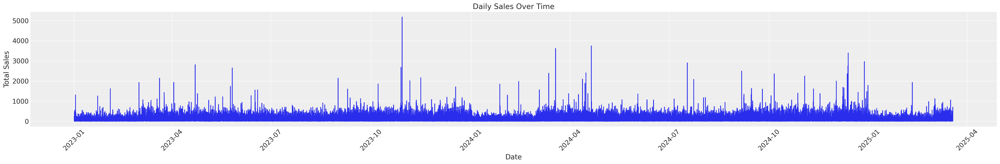

In [ ]:
import matplotlib.pyplot as plt

time = [['Date', 'Line Total']]
time = fr_df.groupby('Date').agg({'Line Total': 'sum'}).reset_index()

plt.figure(figsize=(30, 5))
plt.plot(time['Date'], time['Line Total'])
plt.xlabel('Date')
plt.ylabel('Total Sales')
plt.title('Daily Sales Over Time')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


In [ ]:
# size of the data
diff_time = fr_df['Date'].max() - fr_df['Date'].min()
diff_time

Timedelta('807 days 12:59:00')

In [ ]:
print(fr_df['Date'].max())
print(fr_df['Date'].min())

2025-03-18 20:59:00
2023-01-01 08:00:00


In [ ]:
start_time = fr_df['Date'].min()
end_time = fr_df['Date'].max()

total_duration = end_time - start_time
cutoff_time = start_time + total_duration * 0.76
print(cutoff_time)


2024-09-06 01:32:50.400000


In [ ]:
import pandas as pd

# Giả định cột 'InvoiceDate' đã được định dạng datetime
fr_df['Date'] = pd.to_datetime(fr_df['Date'])

# Xác định khoảng thời gian
start_date = fr_df['Date'].min()
end_date = fr_df['Date'].max()

# Tính ngày kết thúc giai đoạn huấn luyện (80% dữ liệu)
calibration_period_end = pd.to_datetime("2024-08-28")

# Ngày kết thúc giai đoạn quan sát
observation_period_end = end_date

# Chia dữ liệu thành train và test
train_data = fr_df[fr_df['Date'] <= calibration_period_end]
test_data = fr_df[(fr_df['Date'] > calibration_period_end) & (fr_df['Date'] <= observation_period_end)]

# Tính số ngày cho mỗi giai đoạn
train_days = (calibration_period_end - start_date).days + 1
test_days = (observation_period_end - calibration_period_end).days

# Tính số tuần cho mỗi giai đoạn
train_weeks = train_days / 7
test_weeks = test_days / 7

# In kết quả
print("Train Data:", len(train_data), "rows")
print("Test Data:", len(test_data), "rows")
print(f"Train Period: {train_days} days ({train_weeks:.2f} weeks) ({start_date.date()} to {calibration_period_end.date()})")
print(f"Test Period: {test_days} days ({test_weeks:.2f} weeks) ({calibration_period_end.date()} to {observation_period_end.date()})")


Train Data: 416518 rows
Test Data: 198504 rows
Train Period: 605 days (86.43 weeks) (2023-01-01 to 2024-08-28)
Test Period: 202 days (28.86 weeks) (2024-08-28 to 2025-03-18)


In [ ]:
!pip install lifetimes

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 584.2/584.2 kB 9.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 51.5/51.5 kB 3.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 119.7/119.7 kB 8.6 MB/s eta 0:00:00


In [ ]:
from lifetimes.utils import calibration_and_holdout_data
df_rfmt_cal = calibration_and_holdout_data(
    transactions=fr_df,
    customer_id_col="Customer ID",
    datetime_col="Date",
    monetary_value_col="Line Total",
    freq="W",
    calibration_period_end=calibration_period_end,
    observation_period_end= observation_period_end
)

In [ ]:
df_rfmt_cal

,frequency_cal,recency_cal,T_cal,monetary_value_cal,frequency_holdout,monetary_value_holdout,duration_holdout
Customer ID,,,,,,,
1090667,2.0,40.0,78.0,39.875,2.0,71.575000,26.0
1090668,6.0,51.0,64.0,48.405,1.0,36.500000,26.0
1090669,3.0,41.0,65.0,88.000,2.0,26.875000,26.0
1090670,0.0,0.0,38.0,0.000,0.0,0.000000,26.0
1090671,2.0,25.0,55.0,58.675,1.0,31.750000,26.0
...,...,...,...,...,...,...,...
1287340,0.0,0.0,38.0,0.000,0.0,0.000000,26.0
1287344,0.0,0.0,80.0,0.000,0.0,0.000000,26.0
1287348,0.0,0.0,39.0,0.000,1.0,53.166667,26.0


## 1.2. Level 2 Variables

### BG/NBD

#### Validate Model Fitting - Splitted Data


In [ ]:
df_rfmt_cal.index

Index([1090667, 1090668, 1090669, 1090670, 1090671, 1090672, 1090673, 1090674,
       1090677, 1090678,
       ...
       1287299, 1287329, 1287330, 1287331, 1287338, 1287340, 1287344, 1287348,
       1287349, 1287358],
      dtype='int64', name='Customer ID', length=132832)

In [ ]:
df_rfmt_cal.rename_axis("customer_id", inplace=True)

In [ ]:

# Đổi tên các cột trong clean_df_rfmt_ca
df_rfmt_cal = df_rfmt_cal.rename(
    columns={
        'frequency_cal': 'frequency',
        'recency_cal': 'recency',
        'T_cal': 'T',
        'monetary_value_cal': 'monetary_value'
    }
)

# Kiểm tra lại DataFrame sau khi đổi tên
print(df_rfmt_cal.head())


             frequency  recency     T  monetary_value  frequency_holdout  \
customer_id                                                                
1090667            2.0     40.0  78.0          39.875                2.0   
1090668            6.0     51.0  64.0          48.405                1.0   
1090669            3.0     41.0  65.0          88.000                2.0   
1090670            0.0      0.0  38.0           0.000                0.0   
1090671            2.0     25.0  55.0          58.675                1.0   

             monetary_value_holdout  duration_holdout  
customer_id                                            
1090667                      71.575              26.0  
1090668                      36.500              26.0  
1090669                      26.875              26.0  
1090670                       0.000              26.0  
1090671                      31.750              26.0  


# Tạo DataFrame chứa các hàng có giá trị bằng 0
rfm_cal_zero_data = df_rfmt_cal[
    (df_rfmt_cal['frequency'] == 0) |
    (df_rfmt_cal['recency'] == 0) |
    (df_rfmt_cal['monetary_value'] == 0)
]

# Lọc lại rfm_data, bỏ các hàng có giá trị bằng 0
df_rfmt_cal = df_rfmt_cal[
    (df_rfmt_cal['frequency'] > 0)
]

# Kiểm tra kết quả
print(f"Số hàng bị loại bỏ: {len(rfm_cal_zero_data)}")
print(f"Số hàng còn lại trong rfm_data: {len(df_rfmt_cal)}")


In [ ]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Tạo từ điển ánh xạ tên cột

numarical_columns = list(column_names.keys())  # Lấy danh sách cột gốc
colors = ['#20B2AA', '#FF69B4', '#4682B4', '#FFA500']  # Màu đậm nhưng dịu

# Tạo subplot 1 hàng, 4 cột
fig = make_subplots(
    rows=1, cols=4,
    horizontal_spacing=0.12,
    subplot_titles=[column_names[col] for col in numarical_columns]  # Thêm tiêu đề
)

# Thêm từng box plot vào vị trí tương ứng
for i, col in enumerate(numarical_columns):
    fig.add_trace(go.Box(
        y=df_rfmt_cal[col],
        boxmean=True,
        marker_color=colors[i],
        name=column_names[col]
    ), row=1, col=i+1)

# Cập nhật layout tổng thể
fig.update_layout(
    title_font=dict(size=24, family="serif", color="black"),
    height=500,
    width=1200,
    showlegend=True,
    paper_bgcolor="white",
    plot_bgcolor="rgba(240, 240, 240, 0.9)",
    margin=dict(t=80, b=50, l=50, r=50),

    # Cập nhật kích thước và font tiêu đề từng subplot
    annotations=[
        dict(font=dict(size=20, family="serif", color="black")) for _ in numarical_columns
    ]
)

fig.show()


#### Remove Ouliers

In [ ]:
def remove_outliers_iqr(df, cols):
    df_clean = df.copy()
    print("=== Outlier Removal Summary ===")

    for col in cols:
        original_count = len(df_clean)
        Q1 = df[col].quantile(0.25)
        Q3 = df[col].quantile(0.75)
        IQR = Q3 - Q1
        lower = Q1 - 1.5 * IQR
        upper = Q3 + 1.5 * IQR

        # Count outliers trước khi loại
        outliers = df_clean[(df_clean[col] < lower) | (df_clean[col] > upper)]
        outlier_count = len(outliers)

        # Loại outliers
        df_clean = df_clean[(df_clean[col] >= lower) & (df_clean[col] <= upper)]

        # Report
        remaining_count = len(df_clean)
        removed_count = original_count - remaining_count
        removed_pct = (removed_count / original_count) * 100

        print(f"{col}: Removed {removed_count} rows ({removed_pct:.1f}%)")
        print(f"  Range: [{lower:.2f}, {upper:.2f}]")
        print(f"  Remaining: {remaining_count} customers")
        print()

    return df_clean

# Áp dụng
cols_to_clean = ['frequency', 'recency', 'T', 'monetary_value']
original_size = len(df_rfmt_cal)
df_rfmt_clean = remove_outliers_iqr(df_rfmt_cal, cols_to_clean)
final_size = len(df_rfmt_clean)

print("=== FINAL SUMMARY ===")
print(f"Original dataset: {original_size:,} customers")
print(f"After outlier removal: {final_size:,} customers")
print(f"Total removed: {original_size - final_size:,} customers ({((original_size - final_size)/original_size*100):.1f}%)")

=== Outlier Removal Summary ===
frequency: Removed 2968 rows (2.2%)
  Range: [-3.00, 5.00]
  Remaining: 129864 customers

recency: Removed 0 rows (0.0%)
  Range: [-69.00, 115.00]
  Remaining: 129864 customers

T: Removed 0 rows (0.0%)
  Range: [-18.00, 134.00]
  Remaining: 129864 customers

monetary_value: Removed 4698 rows (3.6%)
  Range: [-89.25, 148.75]
  Remaining: 125166 customers

=== FINAL SUMMARY ===
Original dataset: 132,832 customers
After outlier removal: 125,166 customers
Total removed: 7,666 customers (5.8%)


In [ ]:
df_rfmt_clean

,customer_id,frequency,recency,T,monetary_value,frequency_holdout,monetary_value_holdout,duration_holdout
0,1090667,2.0,40.0,78.0,39.875,2.0,71.575000,26.0
2,1090669,3.0,41.0,65.0,88.000,2.0,26.875000,26.0
3,1090670,0.0,0.0,38.0,0.000,0.0,0.000000,26.0
4,1090671,2.0,25.0,55.0,58.675,1.0,31.750000,26.0
5,1090672,4.0,56.0,66.0,98.400,1.0,19.500000,26.0
...,...,...,...,...,...,...,...,...
132827,1287340,0.0,0.0,38.0,0.000,0.0,0.000000,26.0
132828,1287344,0.0,0.0,80.0,0.000,0.0,0.000000,26.0
132829,1287348,0.0,0.0,39.0,0.000,1.0,53.166667,26.0
132830,1287349,0.0,0.0,52.0,0.000,0.0,0.000000,26.0


In [ ]:
# Define the model configuration with alternative priors
model_config = {
    "r_prior": {"dist": "HalfNormal"},  # Use HalfNormal with sigma=1
    "alpha_prior": {"dist": "HalfNormal"},  # Same for alpha
    "a_prior": {"dist": "HalfNormal"},  # HalfNormal for 'a'
    "b_prior": {"dist": "HalfNormal"},  # HalfNormal for 'b'
}
sample_kwargs = {
    "draws": 2_000,
    "chains": 4,
    "target_accept": 0.9,
    "random_seed": 42,
    "cores":4

}

# Initialize the BetaGeoModel with data and model_config
model_mcmc_clean = clv.BetaGeoModel(
    data=df_rfmt_clean,
    model_config=model_config,  # Pass the custom model configuration
)

# Build the model
model_mcmc_clean.build_model()

# Check the model
model_mcmc_clean


BG/NBD
            alpha ~ HalfNormal(0, 1)
                a ~ HalfNormal(0, 1)
                b ~ HalfNormal(0, 1)
                r ~ HalfNormal(0, 1)
recency_frequency ~ BetaGeoNBD(a, b, r, alpha, <constant>)

In [ ]:
model_mcmc_clean.build_model()
model_mcmc_clean

BG/NBD
            alpha ~ HalfNormal(0, 1)
                a ~ HalfNormal(0, 1)
                b ~ HalfNormal(0, 1)
                r ~ HalfNormal(0, 1)
recency_frequency ~ BetaGeoNBD(a, b, r, alpha, <constant>)

In [ ]:
sample_kwargs = {
    "draws": 2_000,
    "chains": 4,
    "target_accept": 0.9,
    "random_seed": 42,
    "cores":4
}

idata_clean = model_mcmc_clean.fit(**sample_kwargs)

Output()

In [ ]:
idata_clean

Inference data with groups:
	> posterior
	> sample_stats
	> observed_data
	> fit_data

In [ ]:
model_mcmc_clean.fit_summary()

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
a,0.595,0.050,0.502,0.687,0.001,0.001,3993.0,4421.0,1.0
alpha,67.515,0.583,66.396,68.585,0.010,0.008,3448.0,3930.0,1.0
b,10.020,0.628,8.881,11.207,0.010,0.008,4176.0,4615.0,1.0
r,1.618,0.013,1.594,1.641,0.000,0.000,3346.0,3430.0,1.0


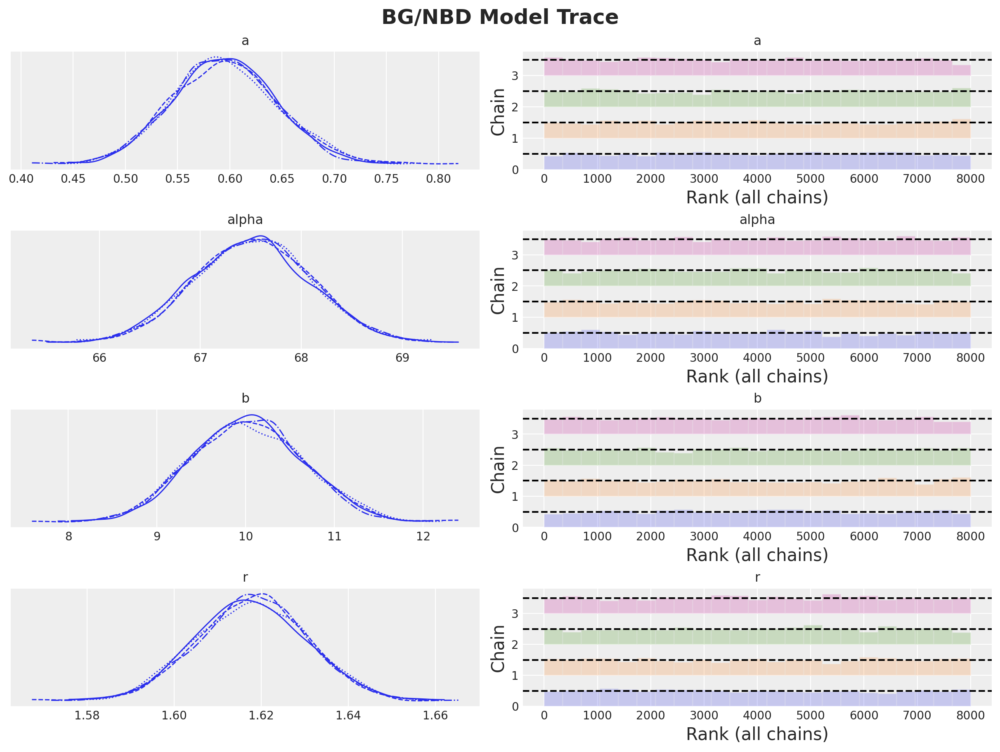

In [ ]:
axes = az.plot_trace(
    data=model_mcmc_clean.idata,
    compact=True,
    kind="rank_bars",
    backend_kwargs={"figsize": (12, 9), "layout": "constrained"},
)
plt.gcf().suptitle("BG/NBD Model Trace", fontsize=18, fontweight="bold");

validate

In [ ]:
df_rfmt_clean['p_alive']=model_mcmc_clean.expected_probability_alive(data=df_rfmt_clean).mean(("chain", "draw")).values
df_rfmt_clean.sort_values(by="p_alive").head(4)

,customer_id,frequency,recency,T,monetary_value,frequency_holdout,monetary_value_holdout,duration_holdout,p_alive
4552,1095960,5.0,19.0,87.0,55.330000,1.0,22.2500,26.0,0.337381
97704,1222206,4.0,12.0,82.0,56.405000,3.0,43.1125,26.0,0.387325
49914,1155057,4.0,16.0,88.0,25.565000,0.0,0.0000,26.0,0.400370
6766,1098541,3.0,12.0,89.0,140.276667,5.0,47.4000,26.0,0.470334


In [ ]:
df_rfmt_clean.sort_values(by="p_alive").tail(4)

,customer_id,frequency,recency,T,monetary_value,frequency_holdout,monetary_value_holdout,duration_holdout,p_alive
132829,1287348,0.0,0.0,39.0,0.0,1.0,53.166667,26.0,1.0
132830,1287349,0.0,0.0,52.0,0.0,0.0,0.000000,26.0,1.0
132831,1287358,0.0,0.0,54.0,0.0,0.0,0.000000,26.0,1.0
3,1090670,0.0,0.0,38.0,0.0,0.0,0.000000,26.0,1.0


In [ ]:
num_purchases = model_mcmc_clean.expected_purchases(future_t=25.29)

df_rfmt_clean["expected_purchases"] = num_purchases.mean(("chain", "draw")).values
df_rfmt_clean.sort_values(by="expected_purchases").tail(4)


,customer_id,frequency,recency,T,monetary_value,frequency_holdout,monetary_value_holdout,duration_holdout,p_alive,expected_purchases
116226,1246972,5.0,29.0,29.0,55.504,1.0,46.000000,26.0,0.959355,1.604652
115041,1245519,5.0,25.0,27.0,86.640,2.0,26.578125,26.0,0.953463,1.627361
54273,1161441,5.0,17.0,24.0,80.330,0.0,0.000000,26.0,0.933067,1.642873
86357,1208469,5.0,26.0,26.0,46.750,2.0,98.250000,26.0,0.959355,1.654310


In [ ]:
from sklearn.metrics import mean_squared_error

mse_pFrequency_bayes=mean_squared_error(df_rfmt_clean["frequency_holdout"], df_rfmt_clean["expected_purchases"])
rmse_pFrequency_bayes = np.sqrt(mse_pFrequency_bayes)
print("RMSE:", rmse_pFrequency_bayes)

RMSE: 0.9280437827476233


In [ ]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import numpy as np

y_true = df_rfmt_clean["frequency_holdout"]
y_pred = df_rfmt_clean["expected_purchases"]

# RMSE
mse = mean_squared_error(y_true, y_pred)
rmse = np.sqrt(mse)

# MAE
mae = mean_absolute_error(y_true, y_pred)

# MAPE
mask = y_true > 0
mape = np.mean(np.abs((y_true[mask] - y_pred[mask]) / y_true[mask]))


print(f"RMSE: {rmse:.4f}")
print(f"MAE : {mae:.4f}")
print(f"MAPE: {mape:.4f}")


RMSE: 0.9280
MAE : 0.7083
MAPE: 0.5625


In [ ]:
print("Actual stats:")
print(df_rfmt_clean["frequency_holdout"].describe())
print("\nPredicted stats:")
print(df_rfmt_clean["expected_purchases"].describe())

Actual stats:
count    125166.000000
mean          0.729983
std           0.928883
min           0.000000
25%           0.000000
50%           0.000000
75%           1.000000
max           9.000000
Name: frequency_holdout, dtype: float64

Predicted stats:
count    125166.000000
mean          0.525476
std           0.202894
min           0.256773
25%           0.377687
50%           0.477309
75%           0.624946
max           1.654310
Name: expected_purchases, dtype: float64


In [ ]:
df_rfmt_clean.corr()

,customer_id,frequency,recency,T,monetary_value,frequency_holdout,monetary_value_holdout,duration_holdout,p_alive,expected_purchases
customer_id,1.000000,-0.094044,-0.073042,-0.097285,-0.075137,0.000798,-0.010420,NaN,0.110284,-0.039551
frequency,-0.094044,1.000000,0.786309,0.443474,0.641894,0.255401,0.164657,NaN,-0.513438,0.867525
recency,-0.073042,0.786309,1.000000,0.576828,0.622184,0.206598,0.134935,NaN,-0.351663,0.595640
T,-0.097285,0.443474,0.576828,1.000000,0.348580,0.110158,0.074646,NaN,-0.397512,-0.020219
monetary_value,-0.075137,0.641894,0.622184,0.348580,1.000000,0.171817,0.114494,NaN,-0.584794,0.519837
frequency_holdout,0.000798,0.255401,0.206598,0.110158,0.171817,1.000000,0.592452,NaN,-0.135363,0.224286
monetary_value_holdout,-0.010420,0.164657,0.134935,0.074646,0.114494,0.592452,1.000000,NaN,-0.096294,0.141745
duration_holdout,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
p_alive,0.110284,-0.513438,-0.351663,-0.397512,-0.584794,-0.135363,-0.096294,NaN,1.000000,-0.258839
expected_purchases,-0.039551,0.867525,0.595640,-0.020219,0.519837,0.224286,0.141745,NaN,-0.258839,1.000000


In [ ]:
test_data

,Invoice ID,Line,Customer ID,Product ID,Size,Color,Unit Price,Quantity,Date,Discount,...,Store ID,Employee ID,Currency,Currency Symbol,SKU,Transaction Type,Payment Method,Invoice Total,City,Country
318797,INV-US-001-03786659,1,1266636,14776,S,NaN,106.50,1,2024-09-22 16:03:00,0.0,...,1,6,USD,$,FESU14776-S-,Sale,Credit Card,106.50,Saint-Nazaire,France
318830,INV-US-001-03786688,1,1151510,14552,XL,NaN,62.00,1,2024-09-22 18:48:00,0.0,...,1,7,USD,$,MASP14552-XL-,Sale,Credit Card,62.00,Marseille,France
324606,INV-US-001-03790706,1,1126311,12718,M,NaN,26.50,1,2024-10-02 09:38:00,0.0,...,1,5,USD,$,FESH12718-M-,Sale,Credit Card,176.10,Créteil,France
324607,INV-US-001-03790706,2,1126311,13860,M,NEUTRAL,67.00,1,2024-10-02 09:38:00,0.2,...,1,5,USD,$,FESW13860-M-NEUTRAL,Sale,Credit Card,176.10,Créteil,France
324608,INV-US-001-03790706,3,1126311,12036,M,NaN,51.50,1,2024-10-02 09:38:00,0.2,...,1,5,USD,$,CHSW12036-M-,Sale,Credit Card,176.10,Créteil,France
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6065237,INV-PT-035-01489121,2,1254302,12976,S,WHITE,56.50,1,2024-12-25 09:43:00,0.5,...,35,399,EUR,€,FESW12976-S-WHITE,Sale,Credit Card,91.25,Nice,France
6065238,INV-PT-035-01489121,3,1254302,14899,M,PINK,81.50,1,2024-12-25 09:43:00,0.5,...,35,399,EUR,€,FECO14899-M-PINK,Sale,Credit Card,91.25,Nice,France
6066894,INV-PT-035-01490353,1,1255054,13182,NaN,NaN,6.00,1,2024-12-26 10:36:00,0.5,...,35,404,EUR,€,CHAC13182--,Sale,Credit Card,47.75,Cagnes-sur-Mer,France
6066895,INV-PT-035-01490353,2,1255054,13656,36,NaN,89.50,1,2024-12-26 10:36:00,0.5,...,35,404,EUR,€,FEPA13656-36-,Sale,Credit Card,47.75,Cagnes-sur-Mer,France


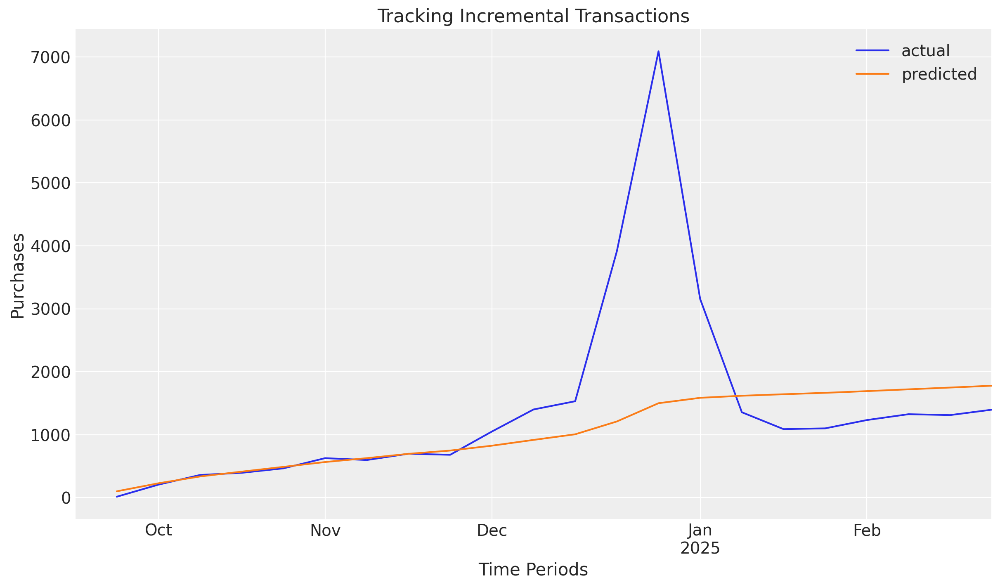

In [ ]:
clv.plot_expected_purchases_over_time(
    model=model_mcmc_clean,
    purchase_history=test_data,
    datetime_col="Date",
    customer_id_col="Customer ID",
    datetime_format="%Y%m%d",
    time_unit="W",
    t=23,
    set_index_date=True,
    plot_cumulative=False,
);

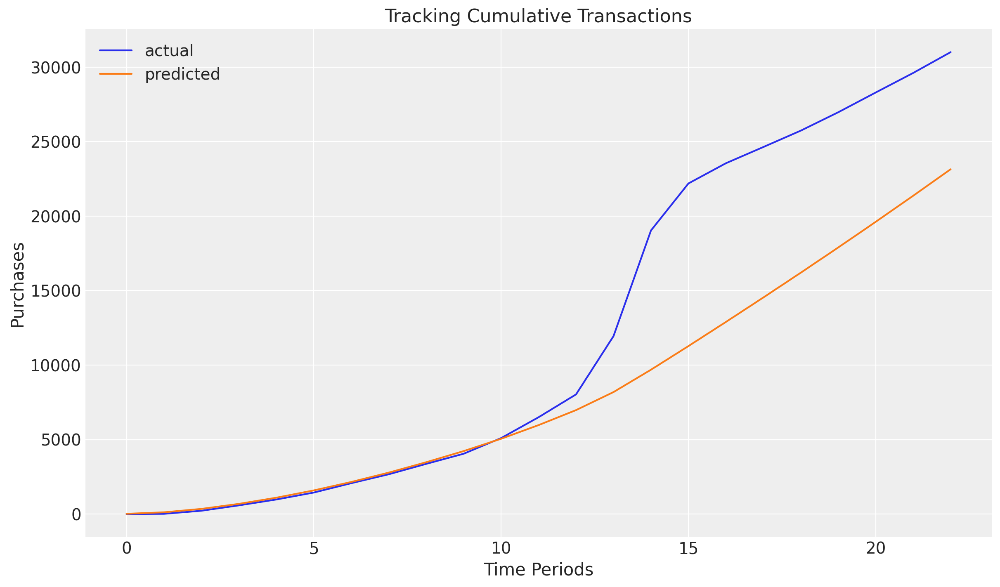

In [ ]:
clv.plot_expected_purchases_over_time(
    model=model_mcmc_clean,
    purchase_history=test_data,
    datetime_col="Date",
    customer_id_col="Customer ID",
    datetime_format="%Y%m%d",
    time_unit="W",
    t=23,
);

In [ ]:
print('Number of purchases predicted:')
print(int(df_rfmt_clean['expected_purchases'].sum()))
print('--------------')
print('Number of purchases occured in actual:')
print(int(df_rfmt_clean['frequency_holdout'].sum()))

Number of purchases predicted:
65771
--------------
Number of purchases occured in actual:
91369


#### Retain Ouliers

In [ ]:
df_rfmt_cal.reset_index(inplace=True)

In [ ]:
# Define the model configuration with alternative priors
model_config = {
    "r_prior": {"dist": "HalfNormal"},  # Use HalfNormal with sigma=1
    "alpha_prior": {"dist": "HalfNormal"},  # Same for alpha
    "a_prior": {"dist": "HalfNormal"},  # HalfNormal for 'a'
    "b_prior": {"dist": "HalfNormal"},  # HalfNormal for 'b'
}
sample_kwargs = {
    "draws": 2_000,
    "chains": 4,
    "target_accept": 0.9,
    "random_seed": 42,
    "cores":4

}

# Initialize the BetaGeoModel with data and model_config
model_mcmc = clv.BetaGeoModel(
    data=df_rfmt_cal,
    model_config=model_config,  # Pass the custom model configuration
)

# Build the model
model_mcmc.build_model()

# Check the model
model_mcmc


BG/NBD
            alpha ~ HalfNormal(0, 1)
                a ~ HalfNormal(0, 1)
                b ~ HalfNormal(0, 1)
                r ~ HalfNormal(0, 1)
recency_frequency ~ BetaGeoNBD(a, b, r, alpha, <constant>)

In [ ]:
model_mcmc.build_model()
model_mcmc

BG/NBD
            alpha ~ HalfNormal(0, 1)
                a ~ HalfNormal(0, 1)
                b ~ HalfNormal(0, 1)
                r ~ HalfNormal(0, 1)
recency_frequency ~ BetaGeoNBD(a, b, r, alpha, <constant>)

In [ ]:
model_mcmc.graphviz()

ImportError: This function requires the python library graphviz, along with binaries. The easiest way to install all of this is by running

	conda install -c conda-forge python-graphviz

In [ ]:
sample_kwargs = {
    "draws": 2_000,
    "chains": 4,
    "target_accept": 0.9,
    "random_seed": 42,
    "cores":4
}

idata = model_mcmc.fit(**sample_kwargs)

Output()

In [ ]:
idata

Inference data with groups:
	> posterior
	> sample_stats
	> observed_data
	> fit_data

In [ ]:
model_mcmc.fit_summary()

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
a,0.276,0.032,0.219,0.339,0.001,0.000,3036.0,3841.0,1.0
alpha,65.350,0.558,64.247,66.336,0.010,0.007,2900.0,3336.0,1.0
b,7.363,0.654,6.179,8.611,0.012,0.008,3125.0,4005.0,1.0
r,1.667,0.013,1.642,1.690,0.000,0.000,2966.0,3460.0,1.0


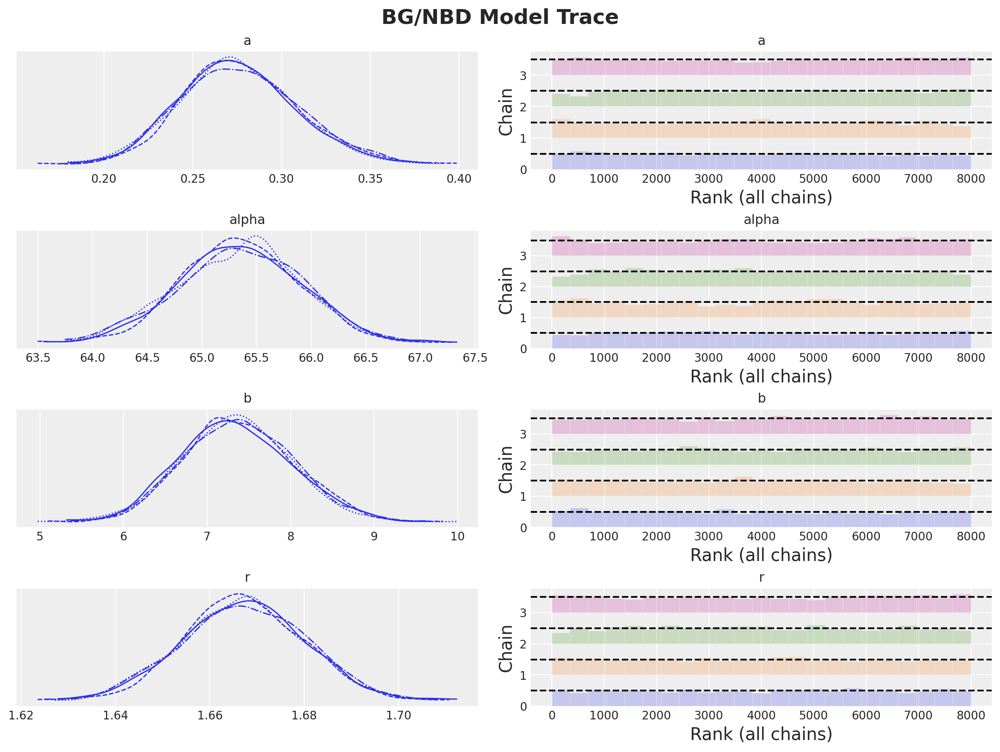

In [ ]:
axes = az.plot_trace(
    data=model_mcmc.idata,
    compact=True,
    kind="rank_bars",
    backend_kwargs={"figsize": (12, 9), "layout": "constrained"},
)
plt.gcf().suptitle("BG/NBD Model Trace", fontsize=18, fontweight="bold");

In [ ]:
df_rfmt_cal['p_alive']=model_mcmc.expected_probability_alive(data=df_rfmt_cal).mean(("chain", "draw")).values
df_rfmt_cal.sort_values(by="p_alive").head(4)

,index,customer_id,frequency,recency,T,monetary_value,frequency_holdout,monetary_value_holdout,duration_holdout,p_alive
4552,4552,1095960,5.0,19.0,87.0,55.330000,1.0,22.2500,26.0,0.445662
97704,97704,1222206,4.0,12.0,82.0,56.405000,3.0,43.1125,26.0,0.494586
61405,61405,1173979,7.0,33.0,88.0,106.821429,2.0,33.8825,26.0,0.508929
49914,49914,1155057,4.0,16.0,88.0,25.565000,0.0,0.0000,26.0,0.509451


In [ ]:
df_rfmt_cal.sort_values(by="p_alive").tail(4)

,index,customer_id,frequency,recency,T,monetary_value,frequency_holdout,monetary_value_holdout,duration_holdout,p_alive
61,61,1090740,0.0,0.0,36.0,0.0,0.0,0.00,26.0,1.0
48,48,1090724,0.0,0.0,1.0,0.0,0.0,0.00,26.0,1.0
43,43,1090718,0.0,0.0,33.0,0.0,1.0,157.50,26.0,1.0
36,36,1090709,0.0,0.0,79.0,0.0,1.0,38.75,26.0,1.0


In [ ]:
num_purchases = model_mcmc.expected_purchases(future_t=25.29)

df_rfmt_cal["expected_purchases"] = num_purchases.mean(("chain", "draw")).values
df_rfmt_cal.sort_values(by="expected_purchases").tail(4)


,index,customer_id,frequency,recency,T,monetary_value,frequency_holdout,monetary_value_holdout,duration_holdout,p_alive,expected_purchases
112966,112966,1243003,11.0,75.0,76.0,79.250909,1.0,52.000000,26.0,0.982949,2.189636
22458,22458,1116870,11.0,71.0,71.0,59.109091,2.0,91.500000,26.0,0.984392,2.271894
18451,18451,1112229,13.0,83.0,86.0,77.938462,2.0,41.875000,26.0,0.981285,2.365114
97016,97016,1221380,13.0,76.0,78.0,58.610769,2.0,22.392857,26.0,0.982827,2.498804


In [ ]:
from sklearn.metrics import mean_squared_error

mse_pFrequency_bayes=mean_squared_error(df_rfmt_cal["frequency_holdout"], df_rfmt_cal["expected_purchases"])
rmse_pFrequency_bayes = np.sqrt(mse_pFrequency_bayes)
print("RMSE:", rmse_pFrequency_bayes)

RMSE: 0.9283225970323561


In [ ]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import numpy as np

y_true = df_rfmt_cal["frequency_holdout"]
y_pred = df_rfmt_cal["expected_purchases"]

# RMSE
mse = mean_squared_error(y_true, y_pred)
rmse = np.sqrt(mse)

# MAE
mae = mean_absolute_error(y_true, y_pred)

# MAPE
mask = y_true > 0
mape = np.mean(np.abs((y_true[mask] - y_pred[mask]) / y_true[mask]))


print(f"RMSE: {rmse:.4f}")
print(f"MAE : {mae:.4f}")
print(f"MAPE: {mape:.4f}")


RMSE: 0.9283
MAE : 0.7153
MAPE: 0.5287


In [ ]:
df_rfmt_cal.corr()

,index,customer_id,frequency,recency,T,monetary_value,frequency_holdout,monetary_value_holdout,duration_holdout,p_alive,expected_purchases
index,1.000000,0.999309,-0.105729,-0.079330,-0.102894,-0.053111,0.000802,-0.010221,NaN,0.105723,-0.059803
customer_id,0.999309,1.000000,-0.106876,-0.081278,-0.103371,-0.054855,-0.001345,-0.012132,NaN,0.107360,-0.061077
frequency,-0.105729,-0.106876,1.000000,0.768175,0.446454,0.413805,0.262127,0.166961,NaN,-0.394114,0.902016
recency,-0.079330,-0.081278,0.768175,1.000000,0.591387,0.453344,0.217142,0.141425,NaN,-0.275926,0.602805
T,-0.102894,-0.103371,0.446454,0.591387,1.000000,0.259807,0.119392,0.079544,NaN,-0.375840,0.046936
monetary_value,-0.053111,-0.054855,0.413805,0.453344,0.259807,1.000000,0.121534,0.084512,NaN,-0.433409,0.346985
frequency_holdout,0.000802,-0.001345,0.262127,0.217142,0.119392,0.121534,1.000000,0.587754,NaN,-0.116231,0.237951
monetary_value_holdout,-0.010221,-0.012132,0.166961,0.141425,0.079544,0.084512,0.587754,1.000000,NaN,-0.083613,0.149935
duration_holdout,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
p_alive,0.105723,0.107360,-0.394114,-0.275926,-0.375840,-0.433409,-0.116231,-0.083613,NaN,1.000000,-0.207814


In [ ]:
test_data

,Invoice ID,Line,Customer ID,Product ID,Size,Color,Unit Price,Quantity,Date,Discount,...,Store ID,Employee ID,Currency,Currency Symbol,SKU,Transaction Type,Payment Method,Invoice Total,City,Country
318797,INV-US-001-03786659,1,1266636,14776,S,NaN,106.50,1,2024-09-22 16:03:00,0.0,...,1,6,USD,$,FESU14776-S-,Sale,Credit Card,106.50,Saint-Nazaire,France
318830,INV-US-001-03786688,1,1151510,14552,XL,NaN,62.00,1,2024-09-22 18:48:00,0.0,...,1,7,USD,$,MASP14552-XL-,Sale,Credit Card,62.00,Marseille,France
324606,INV-US-001-03790706,1,1126311,12718,M,NaN,26.50,1,2024-10-02 09:38:00,0.0,...,1,5,USD,$,FESH12718-M-,Sale,Credit Card,176.10,Créteil,France
324607,INV-US-001-03790706,2,1126311,13860,M,NEUTRAL,67.00,1,2024-10-02 09:38:00,0.2,...,1,5,USD,$,FESW13860-M-NEUTRAL,Sale,Credit Card,176.10,Créteil,France
324608,INV-US-001-03790706,3,1126311,12036,M,NaN,51.50,1,2024-10-02 09:38:00,0.2,...,1,5,USD,$,CHSW12036-M-,Sale,Credit Card,176.10,Créteil,France
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6065237,INV-PT-035-01489121,2,1254302,12976,S,WHITE,56.50,1,2024-12-25 09:43:00,0.5,...,35,399,EUR,€,FESW12976-S-WHITE,Sale,Credit Card,91.25,Nice,France
6065238,INV-PT-035-01489121,3,1254302,14899,M,PINK,81.50,1,2024-12-25 09:43:00,0.5,...,35,399,EUR,€,FECO14899-M-PINK,Sale,Credit Card,91.25,Nice,France
6066894,INV-PT-035-01490353,1,1255054,13182,NaN,NaN,6.00,1,2024-12-26 10:36:00,0.5,...,35,404,EUR,€,CHAC13182--,Sale,Credit Card,47.75,Cagnes-sur-Mer,France
6066895,INV-PT-035-01490353,2,1255054,13656,36,NaN,89.50,1,2024-12-26 10:36:00,0.5,...,35,404,EUR,€,FEPA13656-36-,Sale,Credit Card,47.75,Cagnes-sur-Mer,France


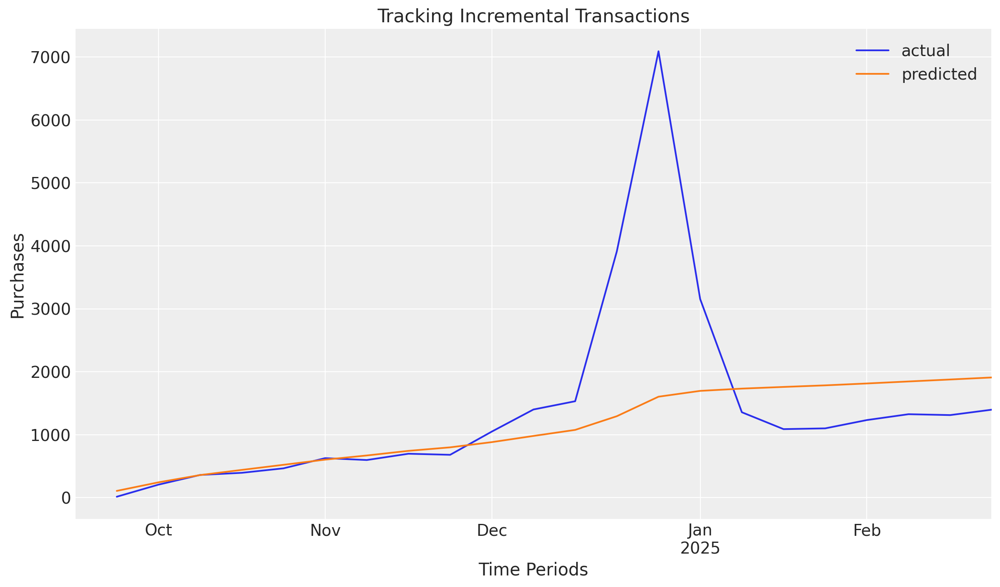

In [ ]:
clv.plot_expected_purchases_over_time(
    model=model_mcmc,
    purchase_history=test_data,
    datetime_col="Date",
    customer_id_col="Customer ID",
    datetime_format="%Y%m%d",
    time_unit="W",
    t=23,
    set_index_date=True,
    plot_cumulative=False,
);

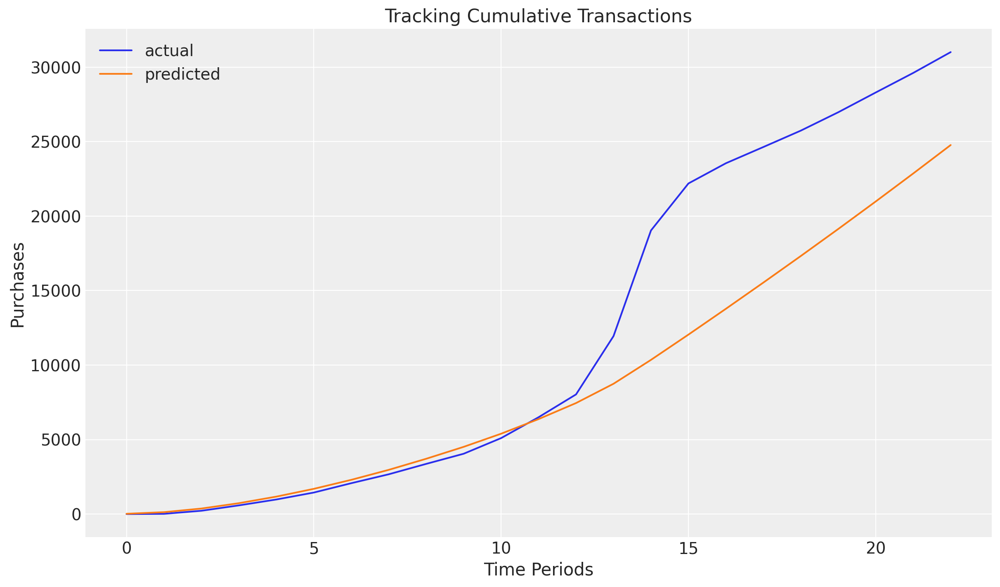

In [ ]:
clv.plot_expected_purchases_over_time(
    model=model_mcmc,
    purchase_history=test_data,
    datetime_col="Date",
    customer_id_col="Customer ID",
    datetime_format="%Y%m%d",
    time_unit="W",
    t=23,
);

In [ ]:
print('Number of purchases predicted:')
print(int(df_rfmt_cal['expected_purchases'].sum()))
print('--------------')
print('Number of purchases occured in actual:')
print(int(df_rfmt_cal['frequency_holdout'].sum()))

Number of purchases predicted:
77614
--------------
Number of purchases occured in actual:
99304


#### Validate Model Fitting - Full Data

In [ ]:
df_rfmt

,customer_id,frequency,recency,T,monetary_value,p_alive
0,1090667,4.0,98.0,104.0,55.725000,0.999972
1,1090668,7.0,78.0,90.0,51.918571,0.999974
2,1090669,5.0,79.0,91.0,74.300000,0.999969
4,1090671,3.0,68.0,81.0,49.700000,0.999955
5,1090672,5.0,91.0,92.0,82.620000,0.999981
...,...,...,...,...,...,...
149162,1287151,1.0,27.0,78.0,33.000000,0.999707
149166,1287173,1.0,34.0,46.0,26.500000,0.999879
149168,1287193,1.0,17.0,27.0,52.850000,0.999880
149182,1287321,1.0,16.0,18.0,36.500000,0.999905


In [ ]:
# Define the model configuration with alternative priors
model_config = {
    "r_prior": {"dist": "HalfNormal", "sigma": 2},     # có thể cần adjust sigma
    "alpha_prior": {"dist": "HalfNormal", "sigma": 10}, # alpha cao thì sigma lớn hơn
    "a_prior": {"dist": "HalfNormal", "sigma": 1},      # start conservative
    "b_prior": {"dist": "HalfNormal", "sigma": 2},
}

sample_kwargs = {
    "draws": 2_000,
    "chains": 4,
    "target_accept": 0.9,
    "random_seed": 42,
    "cores":4
}

# Initialize the BetaGeoModel with data and model_config
model = clv.BetaGeoModel(
    data=df_rfmt,
    model_config=model_config,  # Pass the custom model configuration
)

# Build the model
model.build_model()

# Check the model
model


BG/NBD
            alpha ~ HalfNormal(0, 1)
                a ~ HalfNormal(0, 1)
                b ~ HalfNormal(0, 1)
                r ~ HalfNormal(0, 1)
recency_frequency ~ BetaGeoNBD(a, b, r, alpha, <constant>)

In [ ]:

model.build_model()
model

BG/NBD
            alpha ~ HalfNormal(0, 1)
                a ~ HalfNormal(0, 1)
                b ~ HalfNormal(0, 1)
                r ~ HalfNormal(0, 1)
recency_frequency ~ BetaGeoNBD(a, b, r, alpha, <constant>)

In [ ]:
model.graphviz()

ImportError: This function requires the python library graphviz, along with binaries. The easiest way to install all of this is by running

	conda install -c conda-forge python-graphviz

In [ ]:
sample_kwargs = {
    "draws": 2000,
    "chains": 4,
    "target_accept": 0.9,
    "random_seed": 42,
}

idata_mcmc = model.fit(**sample_kwargs)

Output()

In [ ]:
idata_mcmc

Inference data with groups:
	> posterior
	> sample_stats
	> observed_data
	> fit_data

In [ ]:
model.fit_summary()

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
a,0.106,0.009,0.090,0.123,0.000,0.000,2796.0,2686.0,1.0
alpha,96.925,0.601,95.763,98.059,0.011,0.009,3181.0,2975.0,1.0
b,1.415,0.137,1.162,1.663,0.003,0.002,2761.0,2477.0,1.0
r,3.638,0.022,3.594,3.678,0.000,0.000,3222.0,2811.0,1.0


In [ ]:
# Hardcoded values từ posterior mean
r = 3.638
alpha = 96.925

# Tính lambda
lambda_mean = r / alpha
weeks_per_transaction = 1 / lambda_mean

print(f"λ trung bình (mỗi tuần): {lambda_mean:.4f}")
print(f"Số tuần trung bình cho 1 giao dịch: {weeks_per_transaction:.2f}")


λ trung bình (mỗi tuần): 0.0375
Số tuần trung bình cho 1 giao dịch: 26.64


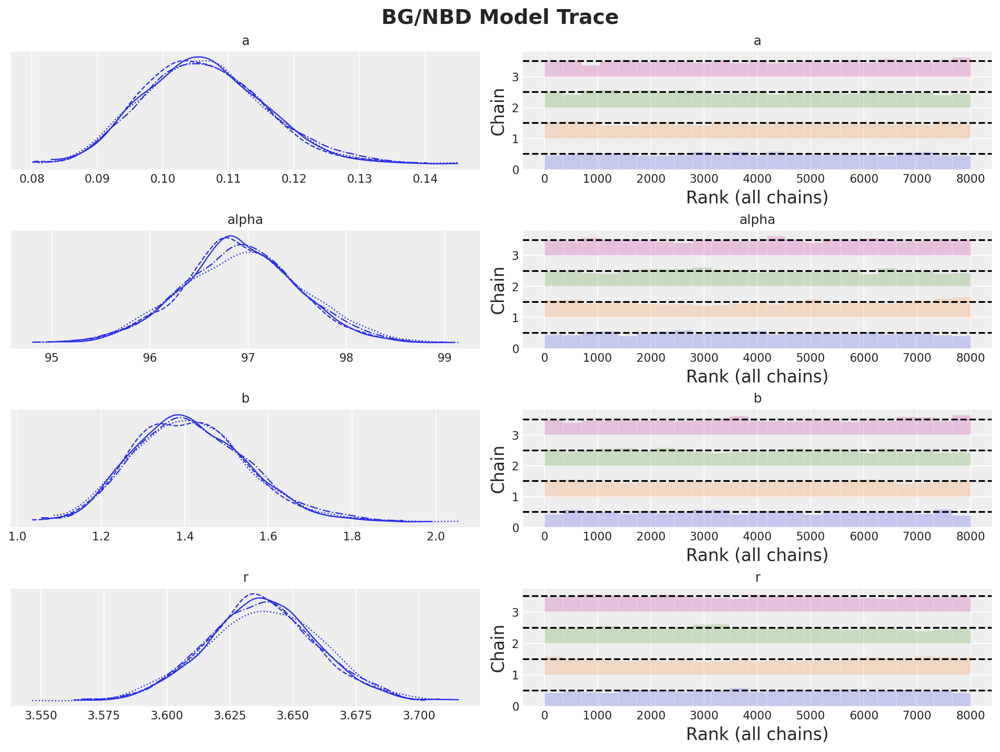

In [ ]:
axes = az.plot_trace(
    data=model.idata,
    compact=True,
    kind="rank_bars",
    backend_kwargs={"figsize": (12, 9), "layout": "constrained"},
)
plt.gcf().suptitle("BG/NBD Model Trace", fontsize=18, fontweight="bold");

/usr/local/lib/python3.11/dist-packages/pymc_marketing/clv/distributions.py:639: RuntimeWarning:

divide by zero encountered in scalar divide

/usr/local/lib/python3.11/dist-packages/pymc_marketing/clv/distributions.py:639: RuntimeWarning:

overflow encountered in scalar divide



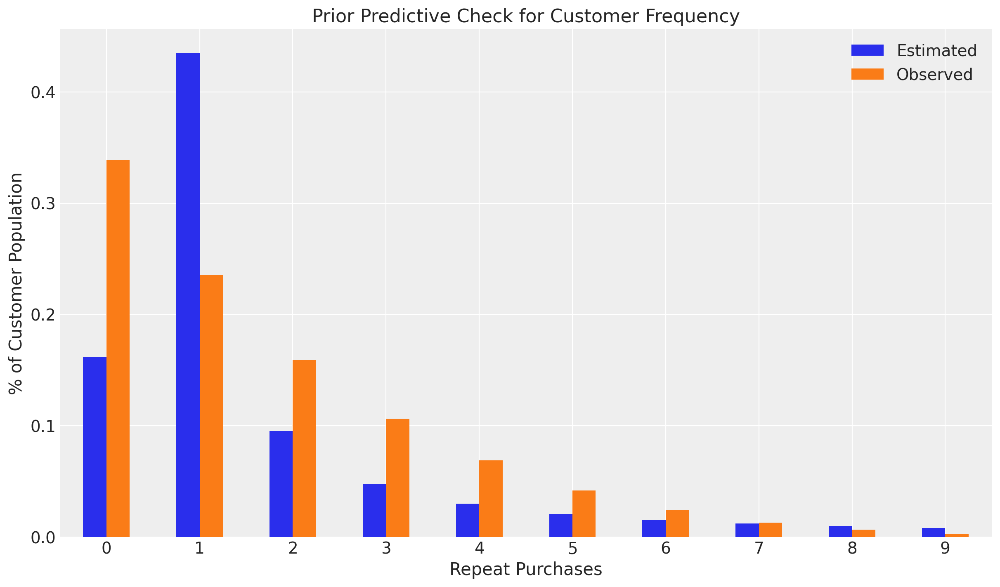

In [ ]:
# PPC histogram plot
clv.plot_expected_purchases_ppc(model, ppc="prior");

Sampling ... ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:00 / 1:30:39

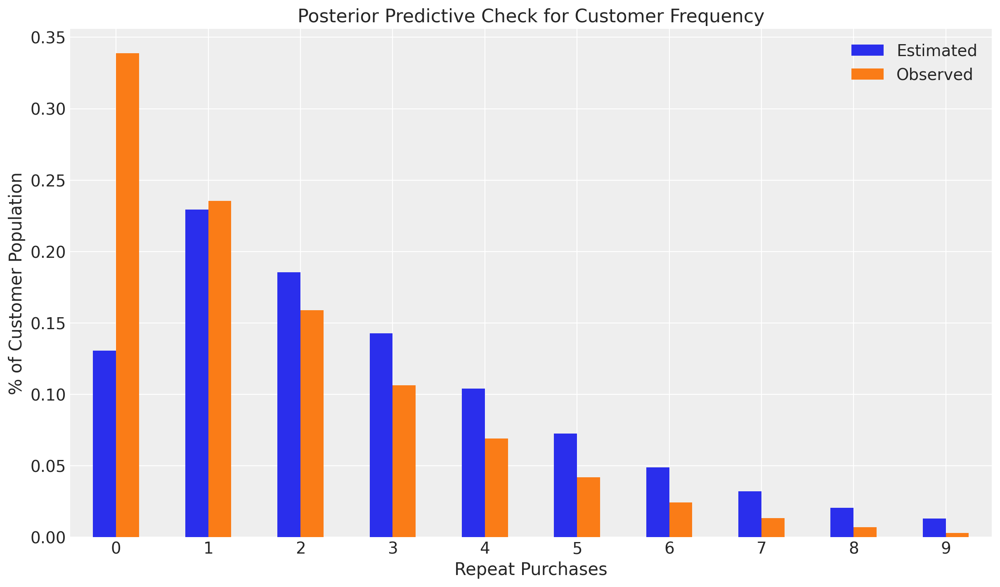

In [ ]:
 #crash due to mememory
clv.plot_expected_purchases_ppc(model, ppc="posterior");

In [ ]:
fr_df

,Invoice ID,Line,Customer ID,Product ID,Size,Color,Unit Price,Quantity,Date,Discount,...,Store ID,Employee ID,Currency,Currency Symbol,SKU,Transaction Type,Payment Method,Invoice Total,City,Country
906,INV-US-001-03559419,1,1222194,396,36,NaN,45.50,1,2023-01-01 13:02:00,0.0,...,1,11,USD,$,FEPA396-36-,Sale,Credit Card,45.50,Toulouse,France
1710,INV-US-001-03559981,1,1256394,1821,S,NEUTRAL,32.00,1,2023-01-01 20:31:00,0.4,...,1,6,USD,$,FECO1821-S-NEUTRAL,Sale,Credit Card,19.20,Antibes,France
2242,INV-US-001-03560380,1,1243390,2560,XXL,BEIGE,36.00,1,2023-01-01 14:13:00,0.4,...,1,7,USD,$,MACO2560-XXL-BEIGE,Sale,Cash,21.60,Nice,France
6562,INV-US-001-03563413,1,1251951,1390,M,RED,39.00,1,2023-01-08 12:12:00,0.4,...,1,10,USD,$,MACO1390-M-RED,Sale,Credit Card,23.40,Nice,France
8227,INV-US-001-03564589,1,1126224,2642,38,NaN,26.50,1,2023-01-10 18:35:00,0.0,...,1,8,USD,$,MAPA2642-38-,Sale,Credit Card,26.50,Créteil,France
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6065237,INV-PT-035-01489121,2,1254302,12976,S,WHITE,56.50,1,2024-12-25 09:43:00,0.5,...,35,399,EUR,€,FESW12976-S-WHITE,Sale,Credit Card,91.25,Nice,France
6065238,INV-PT-035-01489121,3,1254302,14899,M,PINK,81.50,1,2024-12-25 09:43:00,0.5,...,35,399,EUR,€,FECO14899-M-PINK,Sale,Credit Card,91.25,Nice,France
6066894,INV-PT-035-01490353,1,1255054,13182,NaN,NaN,6.00,1,2024-12-26 10:36:00,0.5,...,35,404,EUR,€,CHAC13182--,Sale,Credit Card,47.75,Cagnes-sur-Mer,France
6066895,INV-PT-035-01490353,2,1255054,13656,36,NaN,89.50,1,2024-12-26 10:36:00,0.5,...,35,404,EUR,€,FEPA13656-36-,Sale,Credit Card,47.75,Cagnes-sur-Mer,France


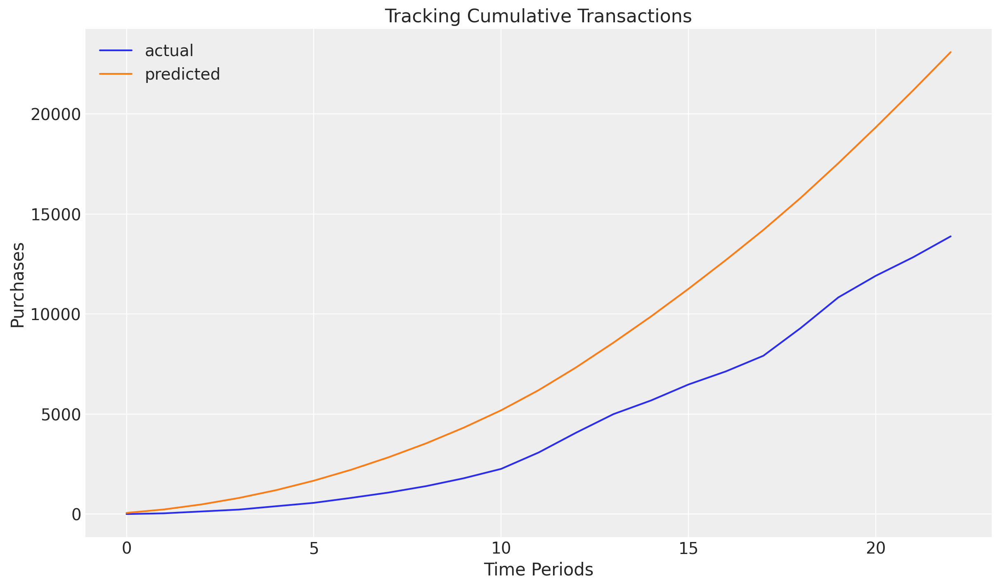

In [ ]:
clv.plot_expected_purchases_over_time(
    model=model,
    purchase_history=fr_df,
    datetime_col="Date",
    customer_id_col="Customer ID",
    datetime_format="%Y%m%d",
    time_unit="W",
    t=23,
);

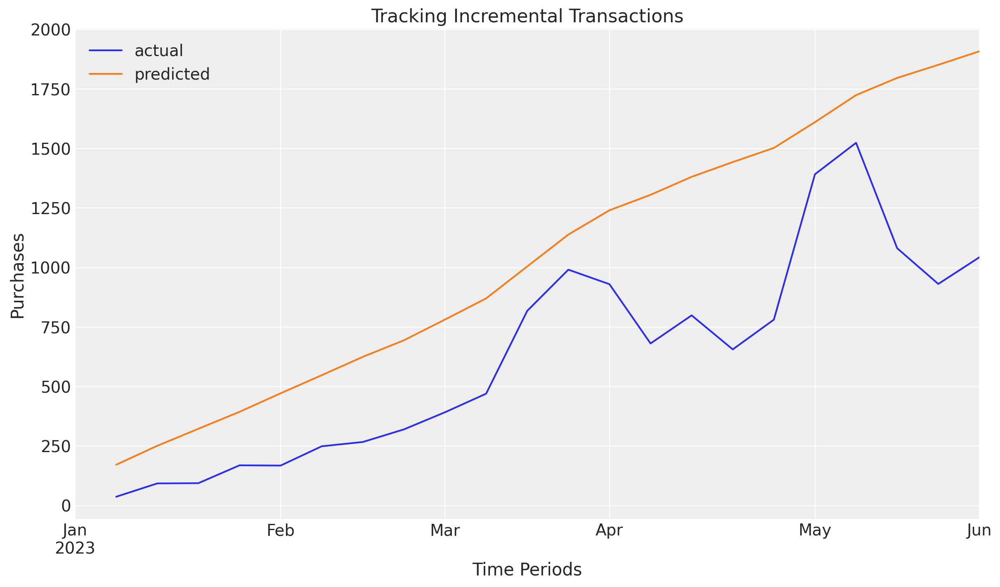

In [ ]:
clv.plot_expected_purchases_over_time(
    model=model,
    purchase_history=fr_df,
    datetime_col="Date",
    customer_id_col="Customer ID",
    datetime_format="%Y%m%d",
    time_unit="W",
    t=23,
    set_index_date=True,
    plot_cumulative=False,
);

##### Build 3 Key Variables: (1) (2) P(alive) at t0 & t0+ deltat & (3)

```
# Định dạng của đoạn này là mã
```



In [ ]:
df_rfmt['p_alive']=model.expected_probability_alive(data=df_rfmt).mean(("chain", "draw")).values
df_rfmt.sort_values(by="p_alive").head(4)

/tmp/ipython-input-74-529771355.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,customer_id,frequency,recency,T,monetary_value,p_alive
54799,1155057,4.0,16.0,114.0,25.565,0.261015
33343,1128912,1.0,1.0,116.0,15.330,0.266274
11892,1103711,1.0,1.0,116.0,18.270,0.266274
34369,1130263,1.0,1.0,115.0,55.300,0.270561


In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(8, 6))
plt.hist(df_rfmt['p_alive'], bins=20, color='skyblue', edgecolor='black')
plt.title('Distribution of p_alive')
plt.xlabel('p_alive')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()

In [ ]:
df_rfmt.sort_values(by="p_alive").tail(4)

In [ ]:
expected_purchases=model.expected_purchases(future_t=24)
df_rfmt['expected_purchases']=expected_purchases.mean(("chain", "draw")).values
df_rfmt.sort_values(by="expected_purchases").tail(4)

/tmp/ipython-input-77-1680033199.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,customer_id,frequency,recency,T,monetary_value,p_alive,expected_purchases
12128,1103963,15.0,99.0,111.0,65.480000,0.979570,2.092695
1351,1092133,12.0,77.0,79.0,50.754167,0.989878,2.093971
108197,1221380,15.0,100.0,104.0,61.246000,0.990080,2.188330
125499,1242369,14.0,83.0,85.0,44.550714,0.991128,2.287810


In [ ]:
df_rfmt['expected_frequency']=df_rfmt['frequency']+df_rfmt['expected_purchases']
df_rfmt.sort_values(by="expected_frequency").tail(4)

/tmp/ipython-input-78-3223337434.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,customer_id,frequency,recency,T,monetary_value,p_alive,expected_purchases,expected_frequency
125499,1242369,14.0,83.0,85.0,44.550714,0.991128,2.287810,16.287810
19651,1112229,15.0,99.0,112.0,73.130000,0.977702,2.078773,17.078773
12128,1103963,15.0,99.0,111.0,65.480000,0.979570,2.092695,17.092695
108197,1221380,15.0,100.0,104.0,61.246000,0.990080,2.188330,17.188330


In [ ]:
future_data = df_rfmt.copy()
future_data["T"] = future_data["T"] + 24
future_data["frequency"] = future_data["frequency"] + future_data["expected_purchases"]
future_data['recency']= future_data["recency"] +24
future_alive = model.expected_probability_alive(data=future_data)

In [ ]:
df_rfmt['p-alive24']=future_alive.mean(("chain", "draw")).values
df_rfmt.sort_values(by="p-alive24").tail(4)

/tmp/ipython-input-80-2836818524.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,customer_id,frequency,recency,T,monetary_value,p_alive,expected_purchases,expected_frequency,p-alive24
121970,1238452,12.0,107.0,107.0,73.188333,0.991521,1.811458,13.811458,0.992592
132301,1249937,12.0,93.0,93.0,61.770833,0.991521,1.943987,13.943987,0.992660
122385,1238924,14.0,106.0,107.0,85.696429,0.992031,2.044536,16.044536,0.993015
44638,1142892,13.0,113.0,113.0,72.325385,0.992148,1.873937,14.873937,0.993103


### Gamma Gamma

#### Validate Model Fitting - Splitted Data


In [ ]:
df_rfmt_cal.index

RangeIndex(start=0, stop=82759, step=1)

In [ ]:
# Filtering out customers with zero frequency to fit the Gamma-Gamma model.
# This model requires customers to have made at least one repeat purchase.

nonzero_data = df_rfmt_cal.query("frequency>0")
nonzero_data

,customer_id,frequency,recency,T,monetary_value,frequency_holdout,monetary_value_holdout,duration_holdout,p_alive,expected_purchases
0,1090667,2.0,40.0,81.0,39.875,2.0,71.575,23.0,0.517847,0.391950
1,1090668,6.0,51.0,67.0,48.405,1.0,36.500,23.0,0.726876,0.999924
2,1090669,3.0,41.0,68.0,88.000,2.0,26.875,23.0,0.621670,0.594110
3,1090671,2.0,25.0,58.0,58.675,1.0,31.750,23.0,0.548105,0.477626
4,1090672,4.0,56.0,69.0,98.400,1.0,19.500,23.0,0.772783,0.839682
...,...,...,...,...,...,...,...,...,...,...
82754,1286656,1.0,19.0,60.0,22.250,0.0,0.000,23.0,0.502247,0.358802
82755,1286742,1.0,2.0,21.0,20.500,0.0,0.000,23.0,0.658365,0.630973
82756,1286805,1.0,2.0,43.0,34.750,0.0,0.000,23.0,0.436673,0.350891
82757,1286912,1.0,8.0,19.0,32.400,0.0,0.000,23.0,0.744888,0.726628


In [ ]:
nonzero_data[["monetary_value", "frequency"]].corr()

,monetary_value,frequency
monetary_value,1.000000,0.005228
frequency,0.005228,1.000000


In [ ]:
# Initializing the Gamma-Gamma model with the prepared data.

gg = clv.GammaGammaModel(
    data = nonzero_data
)
gg.build_model()
gg

Gamma-Gamma Model (Mean Transactions)
         p ~ HalfFlat()
         q ~ HalfFlat()
         v ~ HalfFlat()
likelihood ~ Potential(f(q, p, v))

In [ ]:
gg.build_model()
gg.fit()

Output()

Inference data with groups:
	> posterior
	> sample_stats
	> fit_data

In [ ]:
gg.fit_summary()

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
p,3.084,0.037,3.014,3.156,0.001,0.001,720.0,966.0,1.00
q,6.135,0.079,5.986,6.277,0.003,0.002,734.0,1094.0,1.01
v,109.999,2.782,105.134,115.433,0.109,0.069,650.0,884.0,1.00


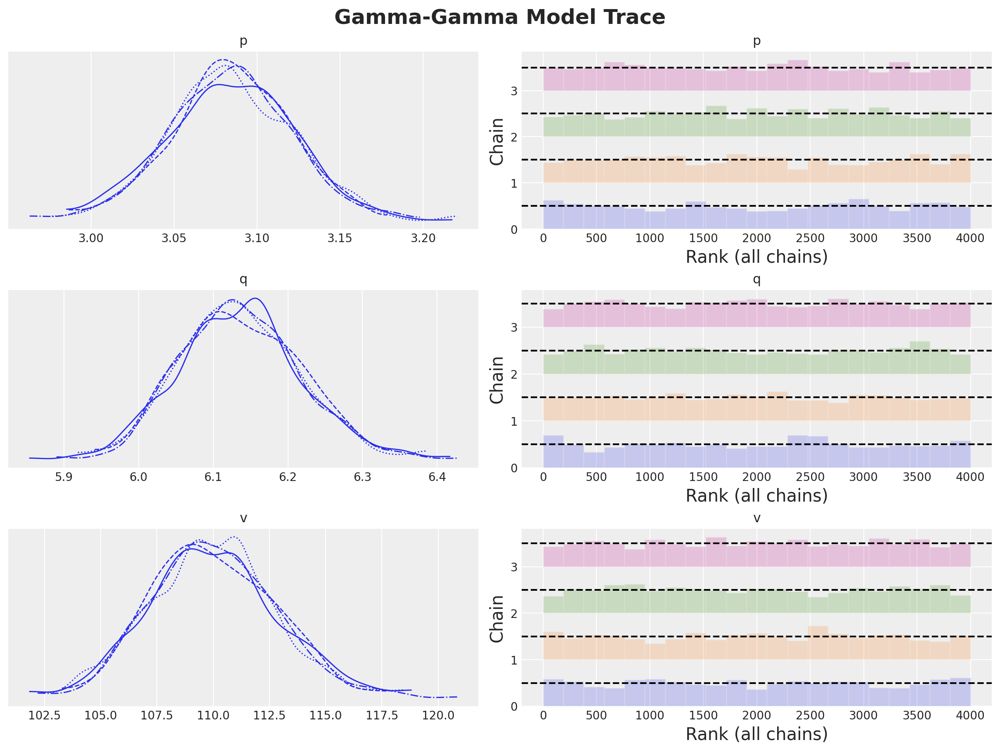

In [ ]:
axes = az.plot_trace(
    data=gg.idata,
    compact=True,
    kind="rank_bars",
    backend_kwargs={"figsize": (12, 9), "layout": "constrained"},
)
plt.gcf().suptitle("Gamma-Gamma Model Trace", fontsize=18, fontweight="bold");

In [ ]:
expected_spend = gg.expected_customer_spend(nonzero_data)

In [ ]:
# Summarizing the expected statistics of average order value for the first ten customers.

az.summary(expected_spend.isel(customer_id=range(10)), kind="stats")

,mean,sd,hdi_3%,hdi_97%
x[1090667],51.764,0.168,51.440,52.070
x[1090668],52.237,0.078,52.088,52.380
x[1090669],80.163,0.149,79.883,80.432
x[1090671],62.023,0.076,61.883,62.169
x[1090672],88.889,0.185,88.524,89.210
x[1090674],59.273,0.130,59.027,59.506
x[1090677],66.403,0.096,66.205,66.572
x[1090678],124.382,0.693,123.096,125.643
x[1090679],49.959,0.121,49.735,50.190
x[1090680],43.756,0.255,43.296,44.253


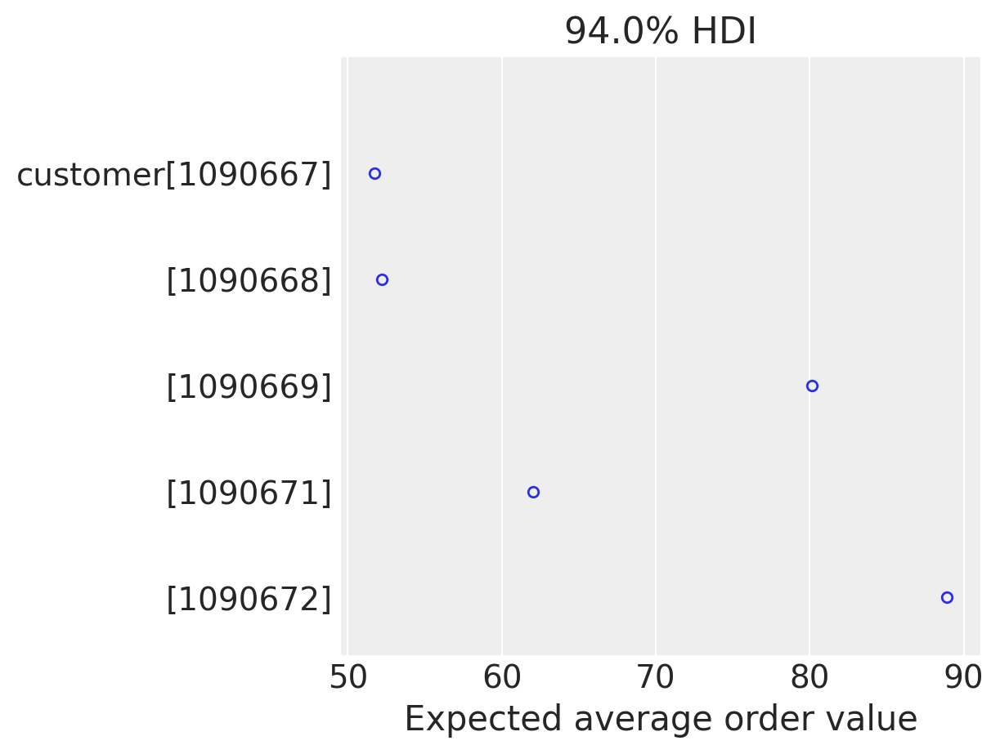

In [ ]:

# Creating a forest plot to visualize the expected spend across customers.

labeller = MapLabeller(var_name_map={"x": "customer"})
az.plot_forest(expected_spend.isel(customer_id=(range(5))), combined=True, labeller=labeller)
plt.xlabel("Expected average order value");

In [ ]:
nonzero_data['expected_monetary_spend']=expected_spend.mean(("chain", "draw")).values
nonzero_data.sort_values(by="expected_monetary_spend").tail(4)

,customer_id,frequency,recency,T,monetary_value,frequency_holdout,monetary_value_holdout,duration_holdout,p_alive,expected_purchases,expected_monetary_spend
39164,1174396,1.0,64.0,90.0,2099.5,0.0,0.0,23.0,0.698279,0.417175,829.103761
23733,1133691,2.0,44.0,56.0,1512.0,0.0,0.0,23.0,0.769554,0.679544,855.093710
81502,1261912,1.0,39.0,69.0,2390.5,0.0,0.0,23.0,0.638479,0.430822,938.302259
69212,1238084,1.0,60.0,85.0,2409.5,1.0,31.5,23.0,0.700028,0.429951,945.432058


In [ ]:
nonzero_data['actual_average_monetary_spend'] = (
    (
        (nonzero_data['monetary_value'] * nonzero_data['frequency']) +
        (nonzero_data['monetary_value_holdout'] * nonzero_data['frequency_holdout'])
    ) /
    (nonzero_data['frequency'] + nonzero_data['frequency_holdout'])
)
nonzero_data

,customer_id,frequency,recency,T,monetary_value,frequency_holdout,monetary_value_holdout,duration_holdout,p_alive,expected_purchases,expected_monetary_spend,actual_average_monetary_spend
0,1090667,2.0,40.0,81.0,39.875,2.0,71.575,23.0,0.517847,0.391950,51.763800,55.725000
1,1090668,6.0,51.0,67.0,48.405,1.0,36.500,23.0,0.726876,0.999924,52.237128,46.704286
2,1090669,3.0,41.0,68.0,88.000,2.0,26.875,23.0,0.621670,0.594110,80.163150,63.550000
3,1090671,2.0,25.0,58.0,58.675,1.0,31.750,23.0,0.548105,0.477626,62.022849,49.700000
4,1090672,4.0,56.0,69.0,98.400,1.0,19.500,23.0,0.772783,0.839682,88.889326,82.620000
...,...,...,...,...,...,...,...,...,...,...,...,...
82754,1286656,1.0,19.0,60.0,22.250,0.0,0.000,23.0,0.502247,0.358802,49.610358,22.250000
82755,1286742,1.0,2.0,21.0,20.500,0.0,0.000,23.0,0.658365,0.630973,48.953666,20.500000
82756,1286805,1.0,2.0,43.0,34.750,0.0,0.000,23.0,0.436673,0.350891,54.301015,34.750000
82757,1286912,1.0,8.0,19.0,32.400,0.0,0.000,23.0,0.744888,0.726628,53.419172,32.400000


In [ ]:
nonzero_data.corr()

,customer_id,frequency,recency,T,monetary_value,frequency_holdout,monetary_value_holdout,duration_holdout,p_alive,expected_purchases,expected_monetary_spend,actual_average_monetary_spend
customer_id,1.000000,-0.068090,-0.016164,-0.090082,0.004763,0.036333,0.015642,NaN,0.075120,0.039373,0.002408,-0.001399
frequency,-0.068090,1.000000,0.530058,0.335106,0.005228,0.198064,0.125917,NaN,0.308465,0.687349,0.008974,0.022301
recency,-0.016164,0.530058,1.000000,0.646066,0.013387,0.114109,0.071123,NaN,0.659184,0.496519,0.015986,0.021126
T,-0.090082,0.335106,0.646066,1.000000,0.006496,0.065376,0.041947,NaN,-0.130986,-0.193569,0.008262,0.013371
monetary_value,0.004763,0.005228,0.013387,0.006496,1.000000,0.001142,0.002430,NaN,0.012335,0.010110,0.969273,0.923649
frequency_holdout,0.036333,0.198064,0.114109,0.065376,0.001142,1.000000,0.567607,NaN,0.072500,0.142781,0.001888,-0.100317
monetary_value_holdout,0.015642,0.125917,0.071123,0.041947,0.002430,0.567607,1.000000,NaN,0.043029,0.088530,0.002545,0.051375
duration_holdout,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
p_alive,0.075120,0.308465,0.659184,-0.130986,0.012335,0.072500,0.043029,NaN,1.000000,0.827016,0.014090,0.014643
expected_purchases,0.039373,0.687349,0.496519,-0.193569,0.010110,0.142781,0.088530,NaN,0.827016,1.000000,0.013008,0.019823


In [ ]:
print('Predicted average monetary value (Vol_PC):')
print(f"{round(nonzero_data['expected_monetary_spend'].sum(), 1)}")
print('------------')
print('Actual average monetary value (Vol_PC):')
print(f"{round(nonzero_data['actual_average_monetary_spend'].sum(), 1)}")


Predicted average monetary value (Vol_PC):
5479795.9
------------
Actual average monetary value (Vol_PC):
5040143.4


In [ ]:
from sklearn.metrics import mean_squared_error
import numpy as np

# Tính MSE và RMSE
mse = mean_squared_error(nonzero_data['actual_average_monetary_spend'], nonzero_data['expected_monetary_spend'])
rmse = np.sqrt(mse)
print("RMSE:", rmse)

RMSE: 26.350035770549578


In [ ]:
nonzero_data[["actual_average_monetary_spend", "expected_monetary_spend"]].describe()

,actual_average_monetary_spend,expected_monetary_spend
count,82759.000000,82759.000000
mean,60.901454,66.213897
std,46.382783,25.595905
min,2.500000,26.938858
25%,35.500000,50.917974
50%,50.025000,59.027769
75%,72.227500,73.630192
max,2390.500000,945.432058


/tmp/ipython-input-73-2465632132.py:33: UserWarning:

The figure layout has changed to tight



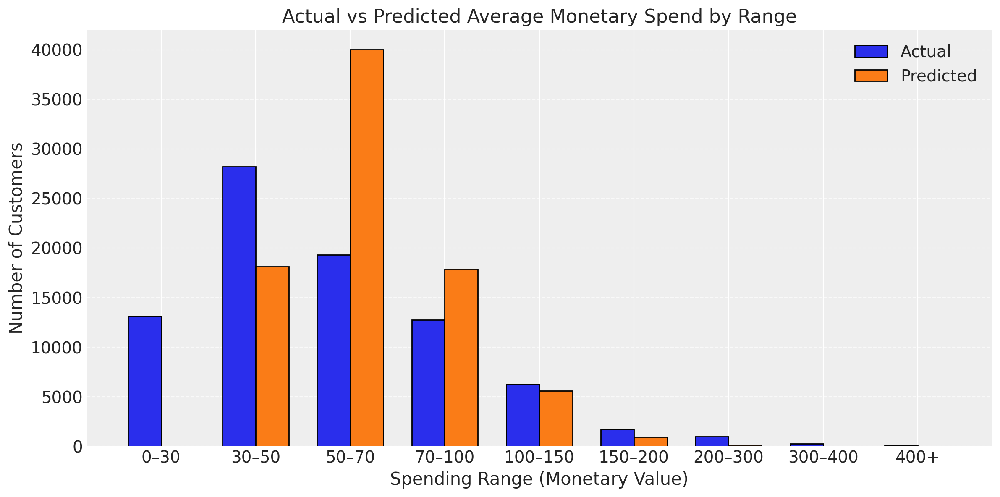

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

# Binning dữ liệu thành các khoảng chi tiêu (VD: theo từng 50 đơn vị)
bins = [0, 30, 50, 70, 100, 150, 200, 300, 400, 700]
labels = ["0–30", "30–50", "50–70", "70–100", "100–150", "150–200", "200–300", "300–400", "400+"]

# Gán nhãn theo bin cho actual & predicted
actual_bins = pd.cut(nonzero_data["actual_average_monetary_spend"], bins=bins, labels=labels)
predicted_bins = pd.cut(nonzero_data["expected_monetary_spend"], bins=bins, labels=labels)

# Đếm số lượng khách trong từng bin
actual_counts = actual_bins.value_counts().sort_index()
predicted_counts = predicted_bins.value_counts().sort_index()

# Thiết lập trục x
x = np.arange(len(labels))
width = 0.35

# Vẽ biểu đồ cột đôi
plt.figure(figsize=(12, 6))
plt.bar(x - width/2, actual_counts, width, color=(42/255, 46/255, 236/255), edgecolor="black", label="Actual")      # Xanh
plt.bar(x + width/2, predicted_counts, width, color=(250/255, 124/255, 23/255), edgecolor="black", label="Predicted")  # Cam

# Tùy chỉnh biểu đồ
plt.xlabel("Spending Range (Monetary Value)")
plt.ylabel("Number of Customers")
plt.title("Actual vs Predicted Average Monetary Spend by Range")
plt.xticks(ticks=x, labels=labels)
plt.legend()
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

#### Validate Model Fitting - Full Data


In [ ]:
df_rfmt.index

Index([     0,      1,      2,      4,      5,      6,      7,      8,      9,
           10,
       ...
       149102, 149109, 149123, 149154, 149155, 149162, 149166, 149168, 149182,
       149190],
      dtype='int64', length=103605)

In [ ]:
# Filtering out customers with zero frequency to fit the Gamma-Gamma model.
# This model requires customers to have made at least one repeat purchase.

nonzero_df = df_rfmt.query("frequency>0")
nonzero_df

,customer_id,frequency,recency,T,monetary_value,p_alive,expected_purchases,expected_frequency,p-alive24
0,1090667,4.0,98.0,104.0,55.725000,0.970607,0.877227,4.877227,0.975387
1,1090668,7.0,78.0,90.0,51.918571,0.971831,1.315697,8.315697,0.976103
2,1090669,5.0,79.0,91.0,74.300000,0.966521,1.056160,6.056160,0.971960
4,1090671,3.0,68.0,81.0,49.700000,0.951127,0.842013,3.842013,0.960630
5,1090672,5.0,91.0,92.0,82.620000,0.979902,1.065165,6.065165,0.983150
...,...,...,...,...,...,...,...,...,...
149162,1287151,1.0,27.0,78.0,33.000000,0.729034,0.456965,1.456965,0.795896
149166,1287173,1.0,34.0,46.0,26.500000,0.898568,0.687239,1.687239,0.930156
149168,1287193,1.0,17.0,27.0,52.850000,0.900063,0.791956,1.791956,0.934320
149182,1287321,1.0,16.0,18.0,36.500000,0.924609,0.876011,1.876011,0.952238


In [ ]:
nonzero_df[["monetary_value", "frequency"]].corr()

,monetary_value,frequency
monetary_value,1.000000,0.020075
frequency,0.020075,1.000000


In [ ]:
# Initializing the Gamma-Gamma model with the prepared data.

gg_full = clv.GammaGammaModel(
    data = nonzero_df
)
gg_full.build_model()
gg_full

Gamma-Gamma Model (Mean Transactions)
         p ~ HalfFlat()
         q ~ HalfFlat()
         v ~ HalfFlat()
likelihood ~ Potential(f(q, p, v))

In [ ]:
gg_full.build_model()
gg_full.fit()

 Progress                    Draws   Divergences   Step size   Grad evals   Sampling Speed   Elapsed   Remaining  
 ───────────────────────────────────────────────────────────────────────────────────────────────────────────────── 
  ━━━━━━━━━━━━━━━━━━━━━━━━━   2000    0             0.10        31           4.03 draws/s     0:08:16   0:00:00    
  ━━━━━━━━━━━━━━━━━━━━━━━━━   2000    0             0.08        5            4.20 draws/s     0:07:56   0:00:00    
  ━━━━━━━━━━━━━━━━━━━━━━━━━   2000    0             0.08        7            4.31 draws/s     0:07:43   0:00:00    
  ━━━━━━━━━━━━━━━━━━━━━━━━━   2000    0             0.10        59           4.29 draws/s     0:07:45   0:00:00

Inference data with groups:
	> posterior
	> sample_stats
	> fit_data

In [ ]:
gg_full.fit_summary()

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
p,2.723,0.027,2.673,2.776,0.001,0.001,864.0,1021.0,1.01
q,7.340,0.090,7.181,7.518,0.003,0.002,881.0,1207.0,1.00
v,148.789,3.308,143.138,155.533,0.118,0.078,797.0,1084.0,1.01


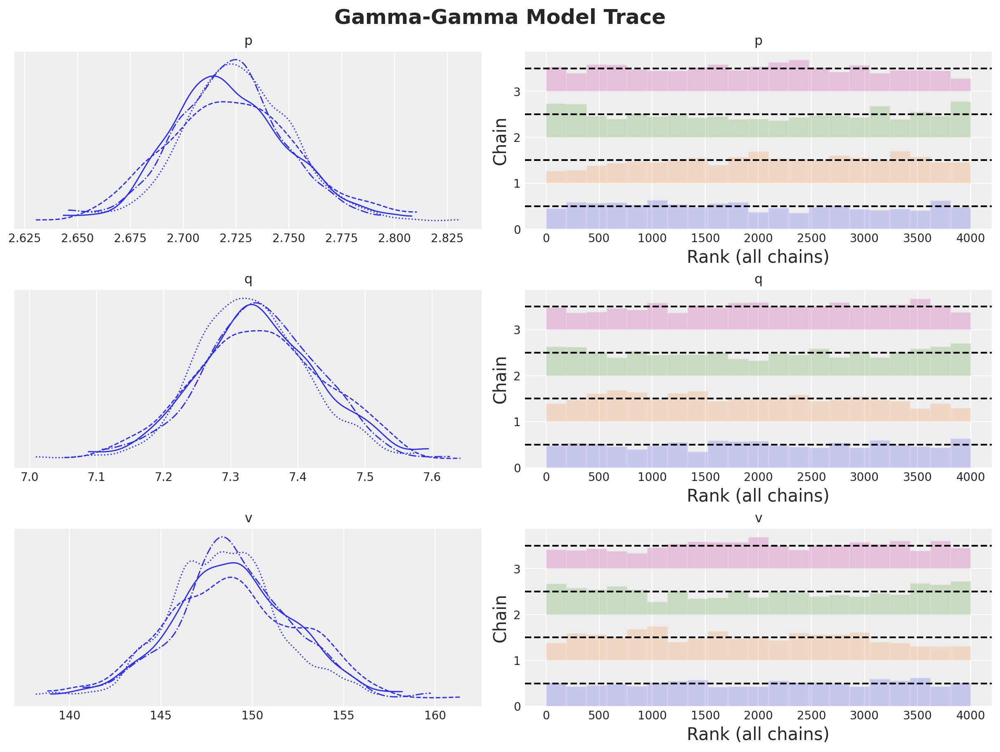

In [ ]:
axes = az.plot_trace(
    data=gg_full.idata,
    compact=True,
    kind="rank_bars",
    backend_kwargs={"figsize": (12, 9), "layout": "constrained"},
)
plt.gcf().suptitle("Gamma-Gamma Model Trace", fontsize=18, fontweight="bold");

In [ ]:
expected_spend_full = gg_full.expected_customer_spend(nonzero_df)

In [ ]:
# Summarizing the expected statistics of average order value for the first ten customers.

az.summary(expected_spend_full.isel(customer_id=range(10)), kind="stats")

In [ ]:

# Creating a forest plot to visualize the expected spend across customers.

labeller = MapLabeller(var_name_map={"x": "customer"})
az.plot_forest(expected_spend_full.isel(customer_id=(range(5))), combined=True, labeller=labeller)
plt.xlabel("Expected average order value");

In [ ]:
nonzero_df['expected_monetary_spend']=expected_spend_full.mean(("chain", "draw")).values
nonzero_df.sort_values(by="expected_monetary_spend").tail(4)

,customer_id,frequency,recency,T,monetary_value,p_alive,expected_purchases,expected_frequency,p-alive24,expected_monetary_spend
137101,1255290,3.0,42.0,67.0,1208.0,0.914803,0.878233,3.878233,0.932639,708.070966
36978,1133691,2.0,44.0,79.0,1512.0,0.867016,0.658416,2.658416,0.896140,733.058135
119354,1235037,2.0,19.0,33.0,1558.0,0.922912,0.945143,2.945143,0.944177,754.314573
142219,1261912,1.0,39.0,92.0,2390.5,0.742938,0.431617,1.431617,0.803020,763.012224


In [ ]:
nonzero_df.corr()

,customer_id,frequency,recency,T,monetary_value,p_alive,expected_purchases,expected_frequency,p-alive24,expected_monetary_spend
customer_id,1.000000,-0.048352,-0.038924,-0.091730,0.002336,0.034753,0.010476,-0.041817,0.039565,-0.000128
frequency,-0.048352,1.000000,0.556143,0.367395,0.020075,0.472248,0.854559,0.997916,0.441595,0.026088
recency,-0.038924,0.556143,1.000000,0.693677,0.002318,0.673932,0.404743,0.546224,0.642236,0.005561
T,-0.091730,0.367395,0.693677,1.000000,0.031597,-0.018248,-0.090002,0.316444,-0.063915,0.030613
monetary_value,0.002336,0.020075,0.002318,0.031597,1.000000,-0.018758,-0.000777,0.017805,-0.020945,0.951371
p_alive,0.034753,0.472248,0.673932,-0.018248,-0.018758,1.000000,0.715274,0.509988,0.997955,-0.012705
expected_purchases,0.010476,0.854559,0.404743,-0.090002,-0.000777,0.715274,1.000000,0.886287,0.704399,0.005804
expected_frequency,-0.041817,0.997916,0.546224,0.316444,0.017805,0.509988,0.886287,1.000000,0.481302,0.023985
p-alive24,0.039565,0.441595,0.642236,-0.063915,-0.020945,0.997955,0.704399,0.481302,1.000000,-0.014700
expected_monetary_spend,-0.000128,0.026088,0.005561,0.030613,0.951371,-0.012705,0.005804,0.023985,-0.014700,1.000000


In [ ]:
nonzero_df

,customer_id,frequency,recency,T,monetary_value,p_alive,expected_purchases,expected_frequency,p-alive24,expected_monetary_spend
0,1090667,4.0,98.0,104.0,55.725000,0.970607,0.877227,4.877227,0.975387,58.730135
1,1090668,7.0,78.0,90.0,51.918571,0.971831,1.315697,8.315697,0.976103,54.907438
2,1090669,5.0,79.0,91.0,74.300000,0.966521,1.056160,6.056160,0.971960,70.993473
4,1090671,3.0,68.0,81.0,49.700000,0.951127,0.842013,3.842013,0.960630,55.901755
5,1090672,5.0,91.0,92.0,82.620000,0.979902,1.065165,6.065165,0.983150,76.670052
...,...,...,...,...,...,...,...,...,...,...
149162,1287151,1.0,27.0,78.0,33.000000,0.729034,0.456965,1.456965,0.795896,54.610034
149166,1287173,1.0,34.0,46.0,26.500000,0.898568,0.687239,1.687239,0.930156,52.656857
149168,1287193,1.0,17.0,27.0,52.850000,0.900063,0.791956,1.791956,0.934320,60.574735
149182,1287321,1.0,16.0,18.0,36.500000,0.924609,0.876011,1.876011,0.952238,55.661745


In [ ]:
nonzero_df.to_csv("prepare_df.csv")

# 2.CLUSTERING: K-MEANS / K-MEANS ++ / K-MEDOIS: Frequency + P_alive_Pmc + Monetary_value

## 2.1. K-MEANS

In [ ]:
import pandas as pd
# Basic import
prepare_df = pd.read_csv('/content/prepare_df.csv')

In [ ]:
!pip install scikit-learn

In [ ]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
prepare_df

,Unnamed: 0,customer_id,frequency,recency,T,monetary_value,p_alive,expected_purchases,expected_frequency,p-alive24,expected_monetary_spend
0,0,1090667,4.0,98.0,104.0,55.725000,0.970607,0.877227,4.877227,0.975387,58.730135
1,1,1090668,7.0,78.0,90.0,51.918571,0.971831,1.315697,8.315697,0.976103,54.907438
2,2,1090669,5.0,79.0,91.0,74.300000,0.966521,1.056160,6.056160,0.971960,70.993473
3,4,1090671,3.0,68.0,81.0,49.700000,0.951127,0.842013,3.842013,0.960630,55.901755
4,5,1090672,5.0,91.0,92.0,82.620000,0.979902,1.065165,6.065165,0.983150,76.670052
...,...,...,...,...,...,...,...,...,...,...,...
103600,149162,1287151,1.0,27.0,78.0,33.000000,0.729034,0.456965,1.456965,0.795896,54.610034
103601,149166,1287173,1.0,34.0,46.0,26.500000,0.898568,0.687239,1.687239,0.930156,52.656857
103602,149168,1287193,1.0,17.0,27.0,52.850000,0.900063,0.791956,1.791956,0.934320,60.574735
103603,149182,1287321,1.0,16.0,18.0,36.500000,0.924609,0.876011,1.876011,0.952238,55.661745


In [ ]:
features = ['p_alive', 'monetary_value', 'frequency']

# Chuẩn hóa các đặc trưng
scaler = StandardScaler()
scaled_features = scaler.fit_transform(prepare_df[features])

### Optimal Value for K in K-means Clustering

Elbow Method - WCSS: INERTIA: TỔNG KHOẢNG CÁCH BÌNH PHƯƠNG ĐẾN TRUNG TÂM CỤM

In [ ]:
!pip install yellowbrick

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 282.6/282.6 kB 5.6 MB/s eta 0:00:00


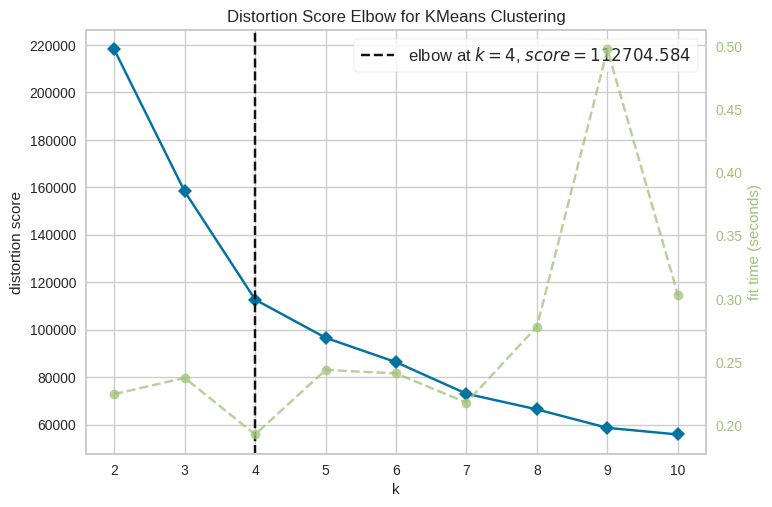

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [ ]:
from yellowbrick.cluster import KElbowVisualizer
from sklearn.cluster import KMeans

# Initialize the KElbowVisualizer with the KMeans estimator and a range of K values
Elbow_M = KElbowVisualizer(KMeans(), k=10)

# Fit the visualizer to the PCA-transformed data
Elbow_M.fit(scaled_features)

# Display the Elbow Method plot
Elbow_M.show()

SILLHOUTE SCORE

In [ ]:
from sklearn.cluster import KMeans
# Select k=4
kmeans = KMeans(n_clusters=4,init='k-means++', random_state=0)
prepare_df['group']= kmeans.fit_predict(scaled_features)

In [ ]:
prepare_df

,Unnamed: 0,customer_id,frequency,recency,T,monetary_value,p_alive,expected_purchases,expected_frequency,p-alive24,expected_monetary_spend,group
0,0,1090667,4.0,98.0,104.0,55.725000,0.970607,0.877227,4.877227,0.975387,58.730135,2
1,1,1090668,7.0,78.0,90.0,51.918571,0.971831,1.315697,8.315697,0.976103,54.907438,2
2,2,1090669,5.0,79.0,91.0,74.300000,0.966521,1.056160,6.056160,0.971960,70.993473,2
3,4,1090671,3.0,68.0,81.0,49.700000,0.951127,0.842013,3.842013,0.960630,55.901755,0
4,5,1090672,5.0,91.0,92.0,82.620000,0.979902,1.065165,6.065165,0.983150,76.670052,2
...,...,...,...,...,...,...,...,...,...,...,...,...
103600,149162,1287151,1.0,27.0,78.0,33.000000,0.729034,0.456965,1.456965,0.795896,54.610034,3
103601,149166,1287173,1.0,34.0,46.0,26.500000,0.898568,0.687239,1.687239,0.930156,52.656857,0
103602,149168,1287193,1.0,17.0,27.0,52.850000,0.900063,0.791956,1.791956,0.934320,60.574735,0
103603,149182,1287321,1.0,16.0,18.0,36.500000,0.924609,0.876011,1.876011,0.952238,55.661745,0


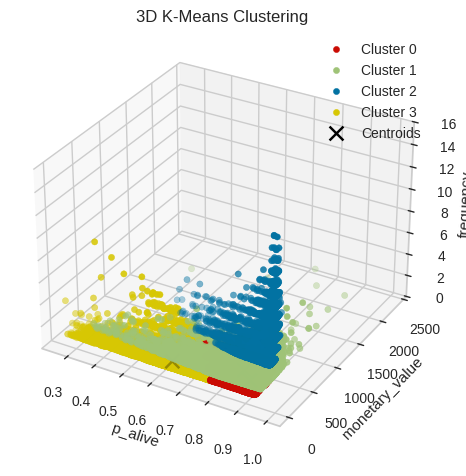

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
from mpl_toolkits.mplot3d import Axes3D

# 3D plot of the clusters
fig = plt.figure(2)
ax = fig.add_subplot(111, projection='3d')

# Assign colors to clusters
colors = ['r', 'g', 'b', 'y']
for group in range(4):
    group_data = prepare_df[prepare_df['group'] == group]
    ax.scatter(group_data['p_alive'], group_data['monetary_value'], group_data['frequency'], c=colors[group], label=f'Cluster {group}')

centroids = kmeans.cluster_centers_
# Transform centroids back to original scale
centroids_original = scaler.inverse_transform(centroids)
ax.scatter(centroids_original[:, 0], centroids_original[:, 1], centroids_original[:, 2], c='black', s=100, marker='x', label='Centroids')

ax.set_xlabel('p_alive')
ax.set_ylabel('monetary_value')
ax.set_zlabel('frequency')
ax.set_title('3D K-Means Clustering')
ax.legend()
plt.show()


## 2.2. K-MEANS ++

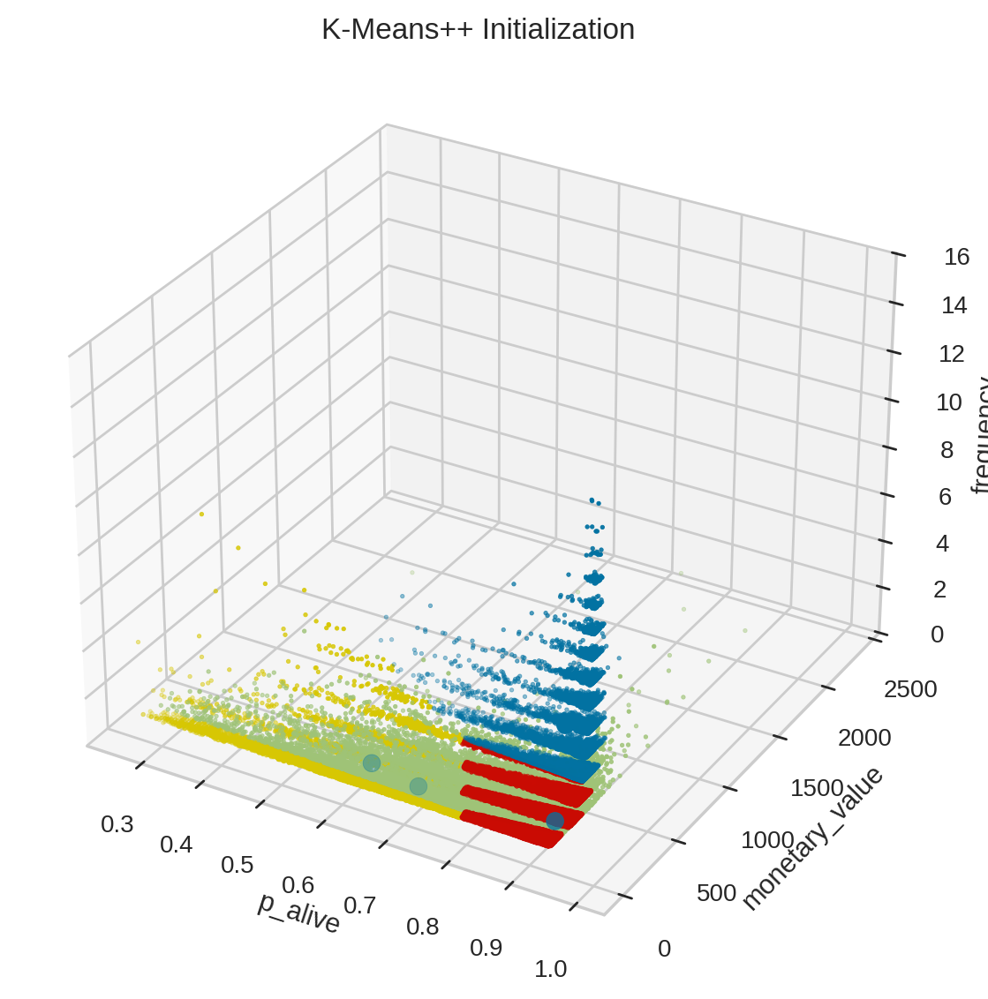

In [ ]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import kmeans_plusplus
import pandas as pd
import numpy as np

# Giả sử bạn đã có DataFrame df với các đặc trưng 'p_alive', 'clv_estimate', 'frequency'
# Định nghĩa các đặc trưng để phân cụm
features = ['p_alive', 'monetary_value', 'frequency']

# Chuẩn hóa các đặc trưng
scaler = StandardScaler()
scaled_features = scaler.fit_transform(prepare_df[features])

# Sử dụng k-means++ để khởi tạo các centroid ban đầu
centers, indices = kmeans_plusplus(scaled_features, n_clusters=4, random_state=0)

# Gán mỗi điểm dữ liệu vào centroid gần nhất
distances = np.linalg.norm(scaled_features[:, np.newaxis] - centers, axis=2)
closest_centroids = np.argmin(distances, axis=1)

original_features = scaler.inverse_transform(scaled_features)
original_centers = scaler.inverse_transform(centers)

# Tạo biểu đồ 3D
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Định nghĩa màu sắc cho các cụm
colors = ['r', 'g', 'b', 'y']
# Vẽ các điểm dữ liệu với màu sắc theo cụm
for k, col in enumerate(colors):
    cluster_data = (closest_centroids == k)
    ax.scatter(original_features[cluster_data, 0], original_features[cluster_data, 1], original_features[cluster_data, 2], c=col, marker='.', s=10)

# Vẽ các centroid ban đầu
ax.scatter(original_centers[:, 0], original_centers[:, 1], original_centers[:, 2], c='b', s=50)

# Thiết lập nhãn cho các trục
ax.set_xlabel('p_alive')
ax.set_ylabel('monetary_value')
ax.set_zlabel('frequency')

plt.title('K-Means++ Initialization')
plt.show()


In [ ]:
# Tính toán số lượng khách hàng và các chỉ số biến trung bình cho mỗi cụm
prepare_df['clusters'] = closest_centroids

## 2.3. K-MEDOIS

In [ ]:
import sys
print(sys.version)


3.11.13 (main, Jun  4 2025, 08:57:29) [GCC 11.4.0]


In [ ]:
# Run this in a cell to fix the issue
!pip uninstall scikit-learn-extra -y
!pip install scikit-learn-extra --no-cache-dir

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 28.9 MB/s eta 0:00:00


In [ ]:
!pip install numpy==1.26.4  # Known compatible version

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.0/61.0 kB 2.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.3/18.3 MB 76.6 MB/s eta 0:00:00
  Attempting uninstall: numpy
    Found existing installation: numpy 2.0.2
    Uninstalling numpy-2.0.2:
      Successfully uninstalled numpy-2.0.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
arviz-stats 0.6.0 requires numpy>=2, but you have numpy 1.26.4 which is incompatible.
preliz 0.20.0 requires numpy>=2.0, but you have numpy 1.26.4 which is incompatible.
thinc 8.3.6 requires numpy<3.0.0,>=2.0.0, but you have numpy 1.26.4 which is incompatible.


In [ ]:
from sklearn_extra.cluster import KMedoids
import numpy as np

In [ ]:
kmedoids = KMedoids(n_clusters=4, metric='euclidean', max_iter=100, random_state=42)
prepare_df['Segment']= kmedoids.fit_predict(scaled_features)

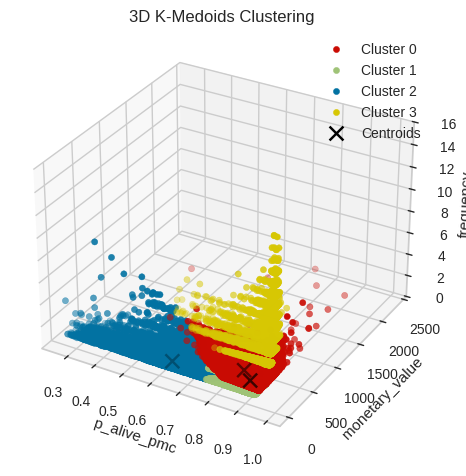

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
from mpl_toolkits.mplot3d import Axes3D

# 3D plot of the clusters
fig = plt.figure(2)
ax = fig.add_subplot(111, projection='3d')

# Assign colors to clusters
colors = ['r', 'g', 'b', 'y']
for group in range(4):
    group_data = prepare_df[prepare_df['Segment'] == group]
    ax.scatter(group_data['p_alive'], group_data['monetary_value'], group_data['frequency'], c=colors[group], label=f'Cluster {group}')

centroids = kmeans.cluster_centers_
# Transform centroids back to original scale
centroids_original = scaler.inverse_transform(centroids)
ax.scatter(centroids_original[:, 0], centroids_original[:, 1], centroids_original[:, 2], c='black', s=100, marker='x', label='Centroids')

ax.set_xlabel('p_alive_pmc')
ax.set_ylabel('monetary_value')
ax.set_zlabel('frequency')
ax.set_title('3D K-Medoids Clustering')
ax.legend()
plt.show()


## 2.4. CLUSTERING TECHNIQUES VALUATION

Silhouette Score: Đo lường mức độ tương đồng của một điểm dữ liệu với cụm của nó so với các cụm khác. Giá trị dao động từ -1 đến 1, với giá trị cao hơn cho thấy phân cụm tốt hơn.
Davies-Bouldin Index: Đánh giá sự phân tách giữa các cụm. Giá trị thấp hơn cho thấy các cụm được phân tách tốt hơn.
Calinski-Harabasz Index: Đo lường tỷ lệ giữa tổng phương sai giữa các cụm và tổng phương sai trong các cụm. Giá trị cao hơn cho thấy phân cụm tốt hơn.

In [ ]:
from sklearn.metrics import silhouette_score, davies_bouldin_score, calinski_harabasz_score

# Tính Silhouette Score
silhouette_avg = silhouette_score(scaled_features, prepare_df['group'])
print(f'Silhouette Score Of K-means: {silhouette_avg}')

silhouette_avg_2 = silhouette_score(scaled_features, prepare_df['clusters'])
print(f'Silhouette Score Of K-means ++: {silhouette_avg_2}')

silhouette_avg_3 = silhouette_score(scaled_features, prepare_df['Segment'])
print(f'Silhouette Score Of K-medois: {silhouette_avg_3}')


Silhouette Score Of K-means: 0.42112877460735887
Silhouette Score Of K-means ++: 0.3954835932554076
Silhouette Score Of K-medois: 0.29872535491802127


In [ ]:
# Tính Davies-Bouldin Index
davies_bouldin = davies_bouldin_score(scaled_features, prepare_df['group'])
print(f'Davies-Bouldin Index  Of K-means: {davies_bouldin}')

davies_bouldin_1 = davies_bouldin_score(scaled_features, prepare_df['clusters'])
print(f'Davies-Bouldin Index  Of K-means ++: {davies_bouldin_1}')

davies_bouldin_2 = davies_bouldin_score(scaled_features, prepare_df['Segment'])
print(f'Davies-Bouldin Index  Of K-medois: {davies_bouldin_2}')

Davies-Bouldin Index  Of K-means: 0.8054578719677699
Davies-Bouldin Index  Of K-means ++: 0.9442040578756157
Davies-Bouldin Index  Of K-medois: 1.130051872368781


In [ ]:
# Tính Calinski-Harabasz Index
calinski_harabasz = calinski_harabasz_score(scaled_features, prepare_df['group'])
print(f'Calinski-Harabasz Index Of K-means: {calinski_harabasz}')

calinski_harabasz_1 = calinski_harabasz_score(scaled_features, prepare_df['clusters'])
print(f'Calinski-Harabasz Index Of K-means ++: {calinski_harabasz_1}')

calinski_harabasz_2 = calinski_harabasz_score(scaled_features, prepare_df['Segment'])
print(f'Calinski-Harabasz Index Of K-medois: {calinski_harabasz_2}')

Calinski-Harabasz Index Of K-means: 60702.66258285367
Calinski-Harabasz Index Of K-means ++: 53094.46630757242
Calinski-Harabasz Index Of K-medois: 44499.77594159555


K-means là phương pháp phân cụm hiệu quả nhất trong ba phương pháp dựa trên các chỉ số silhouette, Davies-Bouldin, và Calinski-Harabasz. Nó có chỉ số silhouette cao nhất, Davies-Bouldin thấp nhất, và Calinski-Harabasz cao nhất, cho thấy sự phân tách rõ rệt giữa các cụm và sự đồng nhất trong mỗi cụm.


LABEL

In [ ]:
# Chuyển đổi cột 'Group' sang kiểu chuỗi để đảm bảo tính nhất quán
prepare_df['group'] = prepare_df['group'].astype(str)

# Tạo cột mới 'cluster_name' dựa trên giá trị của cột 'Group'
cluster_mapping = {
    '0': 'Active',
    '1': 'Champion',
    '2': 'Loyal',
    '3': 'Churn',
}

# Áp dụng ánh xạ để tạo cột 'cluster_name'
prepare_df['cluster_name'] = prepare_df['group'].map(cluster_mapping)

# Hiển thị một số hàng để kiểm tra kết quả
print(prepare_df[['group', 'cluster_name']].sample(10))


      group cluster_name
78140     1     Champion
12505     0       Active
68531     0       Active
69243     0       Active
80610     0       Active
86602     2        Loyal
3168      0       Active
28018     2        Loyal
19307     2        Loyal
75515     0       Active


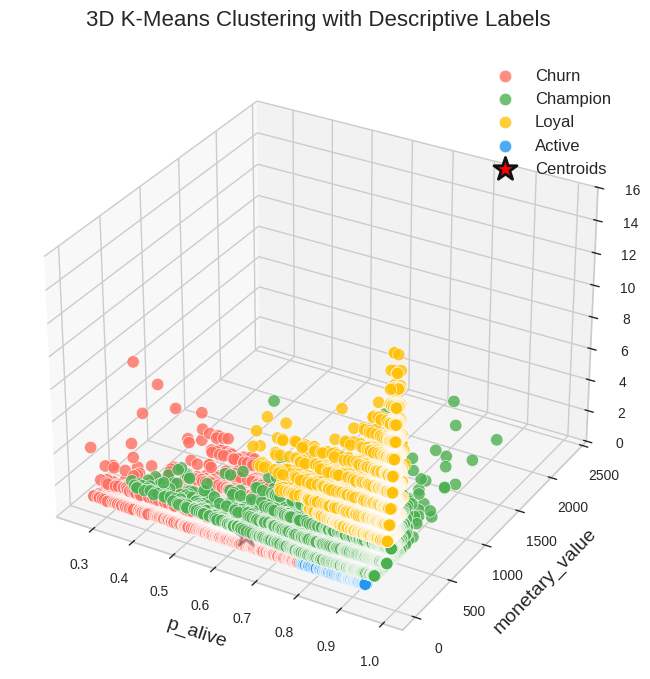

In [ ]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# 3D plot of the clusters with descriptive labels
fig = plt.figure(figsize=(12, 8))  # Tăng kích thước hình
ax = fig.add_subplot(111, projection='3d')

# Chọn màu sắc nhẹ nhàng và tinh tế cho các điểm dữ liệu
colors = {
    'Churn': '#FF6F61',  # Màu đỏ nhẹ cho Churn
    'Champion': '#4CAF50',  # Màu xanh lá cây nhẹ cho Champion
    'Loyal': '#FFC107',  # Màu vàng cho Loyal
    'Active': '#2196F3',  # Màu xanh dương nhẹ cho VIP
}

# Vẽ các nhóm với các nhãn mô tả và màu sắc đã chọn
for label, color in colors.items():
    group_data = prepare_df[prepare_df['cluster_name'] == label]
    ax.scatter(
        group_data['p_alive'],
        group_data['monetary_value'],
        group_data['frequency'],
        c=color, label=label, alpha=0.8, s=80, edgecolors='w', linewidth=0.5  # Vòng viền nhẹ màu trắng
    )

# Vẽ centroids với các điểm nổi bật
centroids = kmeans.cluster_centers_

# Chuyển đổi centroids về lại tỉ lệ ban đầu nếu có sử dụng scaler
centroids_original = scaler.inverse_transform(centroids)

# Vẽ centroids với màu sắc nổi bật và dấu sao lớn
ax.scatter(
    centroids_original[:, 0],
    centroids_original[:, 1],
    centroids_original[:, 2],
    c='red', s=300, marker='*', label='Centroids', edgecolors='k', linewidth=2  # Dấu sao lớn, màu đỏ, viền đen
)

# Tùy chỉnh nhãn trục và tiêu đề với phông chữ rõ ràng và dễ nhìn
ax.set_xlabel('p_alive', fontsize=14, labelpad=10)
ax.set_ylabel('monetary_value', fontsize=14, labelpad=10)
ax.set_zlabel('frequency', fontsize=14, labelpad=10)
ax.set_title('3D K-Means Clustering with Descriptive Labels', fontsize=16, pad=20)

# Thêm lưới nhẹ để dễ dàng theo dõi
ax.grid(True, linestyle='--', alpha=0.3)

# Thêm legend với phông chữ đẹp
ax.legend(loc='best', fontsize=12, frameon=False)

# Hiển thị đồ thị
plt.show()


In [ ]:
import pandas as pd

# Assuming df already has a 'Group' column from clustering results
grouped = prepare_df.groupby('group')

# Get a descriptive summary for each group
for group_name, group_df in grouped:
    print(f"Group: {group_name}")
    print(group_df.describe())


Group: 0
          Unnamed: 0   customer_id     frequency       recency             T  \
count   54488.000000  5.448800e+04  54488.000000  54488.000000  54488.000000   
mean    73860.546579  1.179288e+06      1.899134     58.154952     76.378230   
std     41643.831110  5.103927e+04      0.806625     26.377833     26.783329   
min         4.000000  1.090671e+06      1.000000      1.000000      1.000000   
25%     38963.750000  1.136113e+06      1.000000     40.000000     63.000000   
50%     73945.000000  1.180436e+06      2.000000     59.000000     79.000000   
75%    109968.250000  1.223364e+06      3.000000     78.000000     99.000000   
max    149182.000000  1.287321e+06      4.000000    116.000000    116.000000   

       monetary_value       p_alive  expected_purchases  expected_frequency  \
count    54488.000000  54488.000000        54488.000000        54488.000000   
mean        50.331893      0.906831            0.700202            2.599336   
std         25.620191      0.0467

In [ ]:
prepare_df.to_csv('prepare_df_1.csv', index=False)

# 3.CLUSTERING: K-MEANS / K-MEANS ++ / K-MEDOIS: Frequency + P_alive + Monetary_value

## 3.1. K-MEANS

In [ ]:
!pip install lightgbm

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.6/3.6 MB 38.0 MB/s eta 0:00:00


In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
import lightgbm as lgb

# Chọn các biến đầu vào và biến mục tiêu
features = ["p_alive", "frequency", "monetary_value"]
target = "cluster_name"  # Thay bằng nhãn phân loại thực tế

# Tạo tập huấn luyện và kiểm tra
X_train, X_test, y_train, y_test = train_test_split(
    prepare_df[features], prepare_df[target], test_size=0.2, random_state=42
)


In [ ]:
dt_model = DecisionTreeClassifier(max_depth=5, random_state=42)
dt_model.fit(X_train, y_train)
y_pred_dt = dt_model.predict(X_test)

print("Decision Tree Accuracy:", accuracy_score(y_test, y_pred_dt))
print(classification_report(y_test, y_pred_dt))


Decision Tree Accuracy: 0.9937261715168186
              precision    recall  f1-score   support

      Active       1.00      1.00      1.00     10875
    Champion       0.99      0.95      0.97      1493
       Churn       0.98      1.00      0.99      3000
       Loyal       1.00      1.00      1.00      5353

    accuracy                           0.99     20721
   macro avg       0.99      0.99      0.99     20721
weighted avg       0.99      0.99      0.99     20721



In [ ]:
rf_model = RandomForestClassifier(n_estimators=100, max_depth=7, random_state=42)
rf_model.fit(X_train, y_train)
y_pred_rf = rf_model.predict(X_test)

print("Random Forest Accuracy:", accuracy_score(y_test, y_pred_rf))
print(classification_report(y_test, y_pred_rf))


Random Forest Accuracy: 0.9974422083876261
              precision    recall  f1-score   support

      Active       1.00      1.00      1.00     10875
    Champion       0.99      0.99      0.99      1493
       Churn       1.00      1.00      1.00      3000
       Loyal       1.00      1.00      1.00      5353

    accuracy                           1.00     20721
   macro avg       1.00      0.99      1.00     20721
weighted avg       1.00      1.00      1.00     20721



In [ ]:
lgb_model = lgb.LGBMClassifier(n_estimators=100, max_depth=7, random_state=42)
lgb_model.fit(X_train, y_train)
y_pred_lgb = lgb_model.predict(X_test)

print("LightGBM Accuracy:", accuracy_score(y_test, y_pred_lgb))
print(classification_report(y_test, y_pred_lgb))


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000528 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 526
[LightGBM] [Info] Number of data points in the train set: 82884, number of used features: 3
[LightGBM] [Info] Start training from score -0.642087
[LightGBM] [Info] Start training from score -2.639106
[LightGBM] [Info] Start training from score -1.915187
[LightGBM] [Info] Start training from score -1.366228
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
LightGBM Accuracy: 0.9978282901404373
              precision    recall  f1-score   support

      Active       1.00      1.00      1.00     10875
    Champion       0.99      0.99      0.99      1493
       Churn       1.00      1.00      1.00      3000
       Loyal       1.00      1.00      1.00      5353

    accuracy                           1.00     

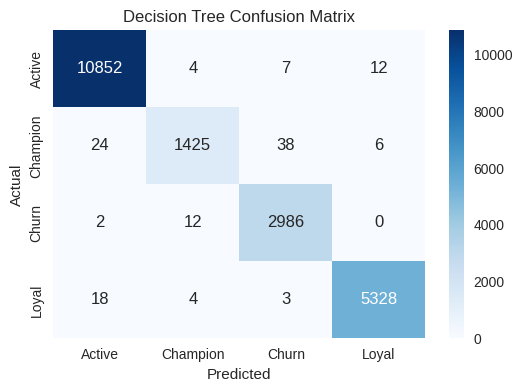

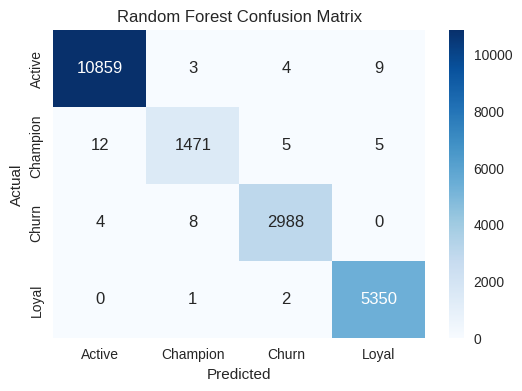

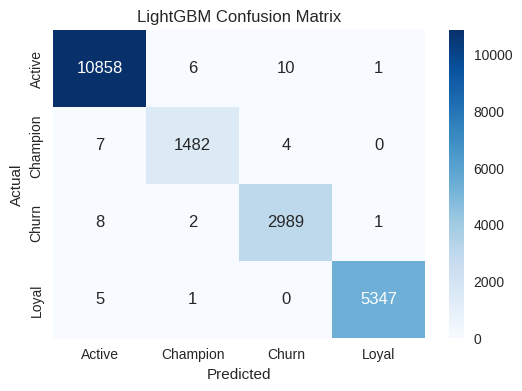

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix

def plot_confusion_matrix(y_true, y_pred, title):
    cm = confusion_matrix(y_true, y_pred)
    plt.figure(figsize=(6, 4))
    sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=np.unique(y_true), yticklabels=np.unique(y_true))
    plt.xlabel("Predicted")
    plt.ylabel("Actual")
    plt.title(title)
    plt.show()

# Vẽ Confusion Matrix cho từng mô hình
plot_confusion_matrix(y_test, y_pred_dt, "Decision Tree Confusion Matrix")
plot_confusion_matrix(y_test, y_pred_rf, "Random Forest Confusion Matrix")
plot_confusion_matrix(y_test, y_pred_lgb, "LightGBM Confusion Matrix")


In [ ]:
from sklearn.metrics import classification_report

print("📌 Decision Tree Performance:")
print(classification_report(y_test, y_pred_dt))

print("📌 Random Forest Performance:")
print(classification_report(y_test, y_pred_rf))

print("📌 LightGBM Performance:")
print(classification_report(y_test, y_pred_lgb))


📌 Decision Tree Performance:
              precision    recall  f1-score   support

      Active       1.00      1.00      1.00     10875
    Champion       0.99      0.95      0.97      1493
       Churn       0.98      1.00      0.99      3000
       Loyal       1.00      1.00      1.00      5353

    accuracy                           0.99     20721
   macro avg       0.99      0.99      0.99     20721
weighted avg       0.99      0.99      0.99     20721

📌 Random Forest Performance:
              precision    recall  f1-score   support

      Active       1.00      1.00      1.00     10875
    Champion       0.99      0.99      0.99      1493
       Churn       1.00      1.00      1.00      3000
       Loyal       1.00      1.00      1.00      5353

    accuracy                           1.00     20721
   macro avg       1.00      0.99      1.00     20721
weighted avg       1.00      1.00      1.00     20721

📌 LightGBM Performance:
              precision    recall  f1-score   su

In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
import lightgbm as lgb

# Chọn các biến đầu vào và biến mục tiêu
features = ["p_alive", "frequency", "monetary_value"]
target = "cluster_name"  # Thay bằng nhãn phân loại thực tế

# Tạo tập huấn luyện và kiểm tra
X_train, X_test, y_train, y_test = train_test_split(
    prepare_df[features], prepare_df[target], test_size=0.2, random_state=42
)

# 🟢 Decision Tree
dt_model = DecisionTreeClassifier(max_depth=5, random_state=42)
dt_model.fit(X_train, y_train)
y_train_pred_dt = dt_model.predict(X_train)
y_test_pred_dt = dt_model.predict(X_test)

# 🟢 Random Forest
rf_model = RandomForestClassifier(n_estimators=100, max_depth=7, random_state=42)
rf_model.fit(X_train, y_train)
y_train_pred_rf = rf_model.predict(X_train)
y_test_pred_rf = rf_model.predict(X_test)

# 🟢 LightGBM
lgb_model = lgb.LGBMClassifier(n_estimators=100, max_depth=7, random_state=42)
lgb_model.fit(X_train, y_train)
y_train_pred_lgb = lgb_model.predict(X_train)
y_test_pred_lgb = lgb_model.predict(X_test)

# 📌 Báo cáo kết quả
def evaluate_model(name, y_train, y_train_pred, y_test, y_test_pred):
    print(f"🔹 {name} Performance 🔹")
    print(f"📌 Accuracy Train: {accuracy_score(y_train, y_train_pred):.4f}")
    print(f"📌 Accuracy Test: {accuracy_score(y_test, y_test_pred):.4f}")
    print("\n📊 Classification Report - Train")
    print(classification_report(y_train, y_train_pred))
    print("\n📊 Classification Report - Test")
    print(classification_report(y_test, y_test_pred))
    print("="*80)

# Hiển thị kết quả từng mô hình
evaluate_model("Decision Tree", y_train, y_train_pred_dt, y_test, y_test_pred_dt)
evaluate_model("Random Forest", y_train, y_train_pred_rf, y_test, y_test_pred_rf)
evaluate_model("LightGBM", y_train, y_train_pred_lgb, y_test, y_test_pred_lgb)


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000554 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 526
[LightGBM] [Info] Number of data points in the train set: 82884, number of used features: 3
[LightGBM] [Info] Start training from score -0.642087
[LightGBM] [Info] Start training from score -2.639106
[LightGBM] [Info] Start training from score -1.915187
[LightGBM] [Info] Start training from score -1.366228
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
🔹 Decision Tree Performance 🔹
📌 Accuracy Train: 0.9941
📌 Accuracy Test: 0.9937

📊 Classification Report - Train
              precision    recall  f1-score   support

      Active       1.00      1.00      1.00     43613
    Champion       0.99      0.96      0.97      5920
       Churn       0.99      1.00      0.99     12210
       Loyal       1.00      

In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split, cross_validate
from sklearn.metrics import precision_score, recall_score, f1_score, make_scorer
from sklearn.preprocessing import LabelEncoder
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
import lightgbm as lgb

# Chọn các biến đầu vào và biến mục tiêu
features = ["p_alive", "frequency", "monetary_value"]
target = "cluster_name"  # Thay bằng tên thực tế của cột nhãn

# Tạo X, y
X = prepare_df[features]
label_encoder = LabelEncoder()
y = label_encoder.fit_transform(prepare_df[target])

# Chia dữ liệu thành tập train/test (80/20)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

# Khởi tạo các mô hình
models = {
    "Decision Tree": DecisionTreeClassifier(max_depth=5, random_state=42),
    "Random Forest": RandomForestClassifier(n_estimators=100, max_depth=7, random_state=42),
    "LightGBM": lgb.LGBMClassifier(n_estimators=100, max_depth=7, random_state=42),
}

# Định nghĩa các hàm đánh giá
scoring = {
    "precision": make_scorer(precision_score, average="weighted", zero_division=1),
    "recall": make_scorer(recall_score, average="weighted", zero_division=1),
    "f1": make_scorer(f1_score, average="weighted", zero_division=1),
}

# Lưu kết quả
results = []
test_results = []

for name, model in models.items():
    # Cross-validation (10-fold)
    scores = cross_validate(model, X_train, y_train, cv=10, scoring=scoring)

    # Huấn luyện mô hình trên tập train
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)

    # Đánh giá trên tập test
    test_precision = precision_score(y_test, y_pred, average="weighted", zero_division=1)
    test_recall = recall_score(y_test, y_pred, average="weighted", zero_division=1)
    test_f1 = f1_score(y_test, y_pred, average="weighted", zero_division=1)

    # Lưu kết quả cho bảng 1 (Cross-validation)
    results.append([
        name,
        np.mean(scores["test_precision"]), np.std(scores["test_precision"]),
        np.mean(scores["test_recall"]), np.std(scores["test_recall"]),
        np.mean(scores["test_f1"]), np.std(scores["test_f1"])
    ])

    # Lưu kết quả cho bảng 2 (Test set)
    test_results.append([name, test_precision, test_recall, test_f1])

# Tạo DataFrame cho bảng 1 (Cross-validation)
df_results = pd.DataFrame(results, columns=[
    "Model", "Precision (mean)", "Precision (std)", "Recall (mean)", "Recall (std)",
    "F1-score (mean)", "F1-score (std)"
])

# Tạo DataFrame cho bảng 2 (Test set)
df_test_results = pd.DataFrame(test_results, columns=["Model", "Precision", "Recall", "F1-score"])

# Xuất bảng đầu tiên
print("\n📊 Table 1: Model Performance with 10-Fold Cross-Validation")
print(df_results.to_string(index=False))

# Xuất bảng thứ hai
print("\n📊 Table 2: Performance on Test Data")
print(df_test_results.to_string(index=False))


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000451 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 526
[LightGBM] [Info] Number of data points in the train set: 74595, number of used features: 3
[LightGBM] [Info] Start training from score -0.642606
[LightGBM] [Info] Start training from score -2.637410
[LightGBM] [Info] Start training from score -1.918643
[LightGBM] [Info] Start training from score -1.363642
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000466 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 526
[LightGBM] [Info] Number of data points in the train set: 74595, number of used features: 3
[LightGBM] [Info] Start training from score -0.642581
[LightGBM] [Info] Start trai

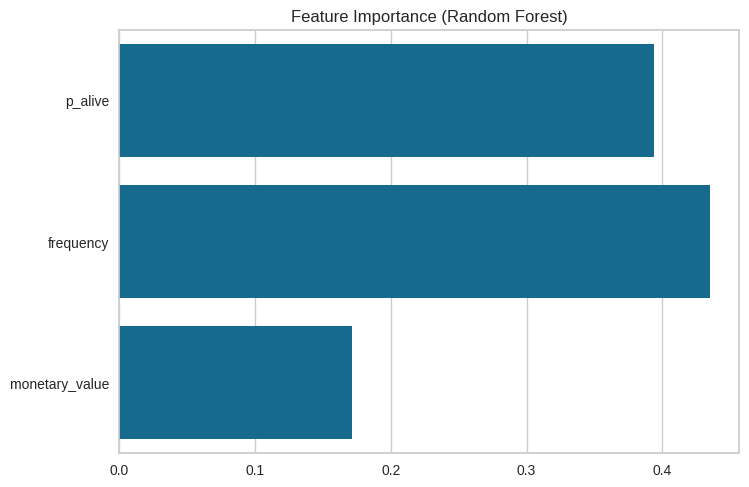

In [ ]:
importances = models["Random Forest"].feature_importances_
feature_names = ["p_alive", "frequency", "monetary_value"]
sns.barplot(x=importances, y=feature_names)
plt.title("Feature Importance (Random Forest)")
plt.show()


In [ ]:
cluster_change_df=prepare_df.copy()

In [ ]:
del cluster_change_df['p_alive']
del cluster_change_df['monetary_value']
del cluster_change_df['frequency']

In [ ]:
cluster_change_df

,Unnamed: 0,customer_id,recency,T,expected_purchases,expected_frequency,p-alive24,expected_monetary_spend,group,clusters,Segment,cluster_name
0,0,1090667,98.0,104.0,0.877227,4.877227,0.975387,58.730135,2,2,3,Loyal
1,1,1090668,78.0,90.0,1.315697,8.315697,0.976103,54.907438,2,2,3,Loyal
2,2,1090669,79.0,91.0,1.056160,6.056160,0.971960,70.993473,2,2,3,Loyal
3,4,1090671,68.0,81.0,0.842013,3.842013,0.960630,55.901755,0,0,0,Active
4,5,1090672,91.0,92.0,1.065165,6.065165,0.983150,76.670052,2,2,3,Loyal
...,...,...,...,...,...,...,...,...,...,...,...,...
103600,149162,1287151,27.0,78.0,0.456965,1.456965,0.795896,54.610034,3,3,2,Churn
103601,149166,1287173,34.0,46.0,0.687239,1.687239,0.930156,52.656857,0,0,1,Active
103602,149168,1287193,17.0,27.0,0.791956,1.791956,0.934320,60.574735,0,0,1,Active
103603,149182,1287321,16.0,18.0,0.876011,1.876011,0.952238,55.661745,0,0,1,Active


In [ ]:
cluster_change_df = cluster_change_df.rename(columns={'p-alive24': 'p_alive',
                                        'expected_frequency': 'frequency',
                                        'expected_monetary_spend': 'monetary_value'})
cluster_change_df


,Unnamed: 0,customer_id,recency,T,expected_purchases,frequency,p_alive,monetary_value,group,clusters,Segment,cluster_name
0,0,1090667,98.0,104.0,0.877227,4.877227,0.975387,58.730135,2,2,3,Loyal
1,1,1090668,78.0,90.0,1.315697,8.315697,0.976103,54.907438,2,2,3,Loyal
2,2,1090669,79.0,91.0,1.056160,6.056160,0.971960,70.993473,2,2,3,Loyal
3,4,1090671,68.0,81.0,0.842013,3.842013,0.960630,55.901755,0,0,0,Active
4,5,1090672,91.0,92.0,1.065165,6.065165,0.983150,76.670052,2,2,3,Loyal
...,...,...,...,...,...,...,...,...,...,...,...,...
103600,149162,1287151,27.0,78.0,0.456965,1.456965,0.795896,54.610034,3,3,2,Churn
103601,149166,1287173,34.0,46.0,0.687239,1.687239,0.930156,52.656857,0,0,1,Active
103602,149168,1287193,17.0,27.0,0.791956,1.791956,0.934320,60.574735,0,0,1,Active
103603,149182,1287321,16.0,18.0,0.876011,1.876011,0.952238,55.661745,0,0,1,Active


In [ ]:
# Đảm bảo thứ tự cột giống với X_train
X_test_new = cluster_change_df[X_train.columns]

# Kiểm tra lại để đảm bảo không còn lỗi
print("X_train columns:", X_train.columns)
print("X_test_new columns:", X_test_new.columns)

# Tiến hành dự đoán
y_pred_dt = dt_model.predict(X_test_new)


X_train columns: Index(['p_alive', 'frequency', 'monetary_value'], dtype='object')
X_test_new columns: Index(['p_alive', 'frequency', 'monetary_value'], dtype='object')


In [ ]:
cluster_change_df['cluster_new']= y_pred_dt

In [ ]:
cluster_change_df

,Unnamed: 0,customer_id,recency,T,expected_purchases,frequency,p_alive,monetary_value,group,clusters,Segment,cluster_name,cluster_new
0,0,1090667,98.0,104.0,0.877227,4.877227,0.975387,58.730135,2,2,3,Loyal,Loyal
1,1,1090668,78.0,90.0,1.315697,8.315697,0.976103,54.907438,2,2,3,Loyal,Loyal
2,2,1090669,79.0,91.0,1.056160,6.056160,0.971960,70.993473,2,2,3,Loyal,Loyal
3,4,1090671,68.0,81.0,0.842013,3.842013,0.960630,55.901755,0,0,0,Active,Loyal
4,5,1090672,91.0,92.0,1.065165,6.065165,0.983150,76.670052,2,2,3,Loyal,Loyal
...,...,...,...,...,...,...,...,...,...,...,...,...,...
103600,149162,1287151,27.0,78.0,0.456965,1.456965,0.795896,54.610034,3,3,2,Churn,Active
103601,149166,1287173,34.0,46.0,0.687239,1.687239,0.930156,52.656857,0,0,1,Active,Active
103602,149168,1287193,17.0,27.0,0.791956,1.791956,0.934320,60.574735,0,0,1,Active,Active
103603,149182,1287321,16.0,18.0,0.876011,1.876011,0.952238,55.661745,0,0,1,Active,Active


In [ ]:

import pandas as pd

# Tạo bảng tần suất giữa cluster_name và cluster_52
cluster_transition = pd.crosstab(cluster_change_df['cluster_name'], cluster_change_df['cluster_new'])

# Hiển thị kết quả
print(cluster_transition)


cluster_new   Active  Champion  Churn  Loyal
cluster_name                                
Active         39994         0      0  14494
Champion        4000      1411    556   1446
Churn           4654         0  10301    255
Loyal              0         2      0  26492


In [ ]:
import plotly.graph_objects as go

# Chuẩn bị dữ liệu cho Sankey diagram
source = []
target = []
values = []

for i, source_cluster in enumerate(cluster_transition.index):
    for j, target_cluster in enumerate(cluster_transition.columns):
        count = cluster_transition.iloc[i, j]
        if count > 0:  # Chỉ thêm nếu có thay đổi
            source.append(source_cluster)
            target.append(target_cluster)
            values.append(count)

# Vẽ biểu đồ Sankey
fig = go.Figure(go.Sankey(
    node=dict(
        pad=20,
        thickness=20,
        line=dict(color="black", width=0.5),
        label=list(cluster_transition.index) + list(cluster_transition.columns),
    ),
    link=dict(
        source=[list(cluster_transition.index).index(s) for s in source],
        target=[list(cluster_transition.columns).index(t) + len(cluster_transition.index) for t in target],
        value=values,
    ),
))

fig.show()


In [ ]:
cluster_change_df

,Unnamed: 0,customer_id,recency,T,expected_purchases,frequency,p_alive,monetary_value,group,clusters,Segment,cluster_name,cluster_new
0,0,1090667,98.0,104.0,0.877227,4.877227,0.975387,58.730135,2,2,3,Loyal,Loyal
1,1,1090668,78.0,90.0,1.315697,8.315697,0.976103,54.907438,2,2,3,Loyal,Loyal
2,2,1090669,79.0,91.0,1.056160,6.056160,0.971960,70.993473,2,2,3,Loyal,Loyal
3,4,1090671,68.0,81.0,0.842013,3.842013,0.960630,55.901755,0,0,0,Active,Loyal
4,5,1090672,91.0,92.0,1.065165,6.065165,0.983150,76.670052,2,2,3,Loyal,Loyal
...,...,...,...,...,...,...,...,...,...,...,...,...,...
103600,149162,1287151,27.0,78.0,0.456965,1.456965,0.795896,54.610034,3,3,2,Churn,Active
103601,149166,1287173,34.0,46.0,0.687239,1.687239,0.930156,52.656857,0,0,1,Active,Active
103602,149168,1287193,17.0,27.0,0.791956,1.791956,0.934320,60.574735,0,0,1,Active,Active
103603,149182,1287321,16.0,18.0,0.876011,1.876011,0.952238,55.661745,0,0,1,Active,Active


In [ ]:
cluster_change_df.to_csv("cluster_change_df.csv")

In [ ]:
import pandas as pd
# Basic import
cluster_change_df = pd.read_csv('/content/cluster_change_df.csv')

In [ ]:
import pandas as pd
# Basic import
prepare_df = pd.read_csv('/content/prepare_df_1.csv')

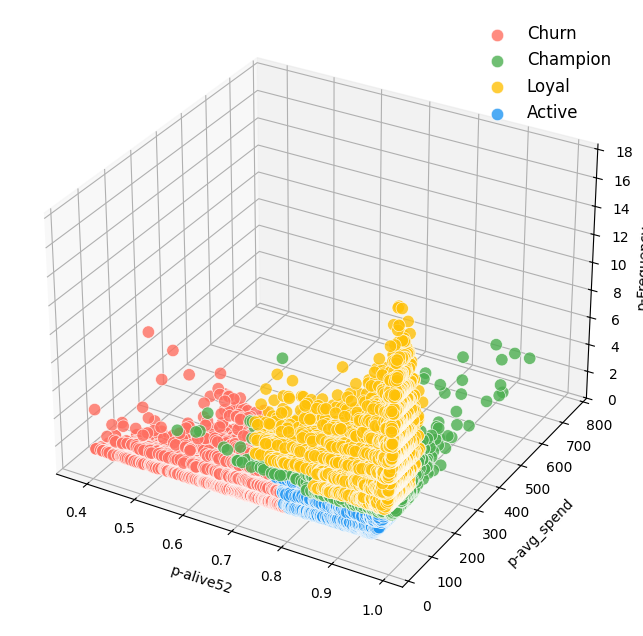

In [ ]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# 3D plot of the clusters with descriptive labels
fig = plt.figure(figsize=(12, 8))  # Tăng kích thước hình
ax = fig.add_subplot(111, projection='3d')

# Chọn màu sắc nhẹ nhàng và tinh tế cho các điểm dữ liệu
colors = {
    'Churn': '#FF6F61',  # Màu đỏ nhẹ cho Churn
    'Champion': '#4CAF50',  # Màu xanh lá cây nhẹ cho Champion
    'Loyal': '#FFC107',  # Màu vàng cho Loyal
    'Active': '#2196F3',  # Màu xanh dương nhẹ cho VIP
}

# Vẽ các nhóm với các nhãn mô tả và màu sắc đã chọn
for label, color in colors.items():
    group_data = cluster_change_df[cluster_change_df['cluster_new'] == label]
    ax.scatter(
        group_data['p_alive'],
        group_data['monetary_value'],
        group_data['frequency'],
        c=color, label=label, alpha=0.8, s=80, edgecolors='w', linewidth=0.5  # Vòng viền nhẹ màu trắng
    )

# Tùy chỉnh nhãn trục và tiêu đề với phông chữ rõ ràng và dễ nhìn
ax.set_xlabel('p-alive52', fontsize=10, labelpad=5)
ax.set_ylabel('p-avg_spend', fontsize=10, labelpad=7)
ax.set_zlabel('p-Frequency', fontsize=10, labelpad=2)

# Thêm lưới nhẹ để dễ dàng theo dõi
ax.grid(True, linestyle='--', alpha=0.3)

# Thêm legend với phông chữ đẹp
ax.legend(loc='best', fontsize=12, frameon=False)

# Hiển thị đồ thị
plt.show()


In [ ]:
import pandas as pd

# Assuming df already has a 'Group' column from clustering results
grouped = cluster_change_df.groupby('cluster_new')

# Get a descriptive summary for each group
for group_name, group_df in grouped:
    print(f"cluster_new: {group_name}")
    print(group_df.describe())


cluster_new: Active
          Unnamed: 0   customer_id       recency             T  \
count   48648.000000  4.864800e+04  48648.000000  48648.000000   
mean    74400.939525  1.179966e+06     51.155998     73.341145   
std     41465.782145  5.087549e+04     26.671804     27.248100   
min         6.000000  1.090673e+06      1.000000      1.000000   
25%     39764.000000  1.137080e+06     31.000000     55.000000   
50%     73875.500000  1.180358e+06     51.000000     75.000000   
75%    110342.750000  1.223778e+06     70.000000     97.000000   
max    149190.000000  1.287348e+06    116.000000    116.000000   

       expected_purchases     frequency       p_alive  monetary_value  \
count        48648.000000  48648.000000  48648.000000    48648.000000   
mean             0.642228      2.126441      0.910048       61.612319   
std              0.131581      0.584434      0.049564       14.684073   
min              0.373439      1.373439      0.752571       35.191267   
25%              0.5

In [ ]:
import plotly.graph_objects as go
import pandas as pd

# ------------------------------------------------------
# Giả định df_rfmt & cluster_change_df đã có dữ liệu:
# df_rfmt:  ['customer_id','p_alive_pmcy','frequency','monetary_value','cluster_name']
# cluster_change_df: ['customer_id','p_alive_pmcy','frequency','monetary_value','cluster_52']
# ------------------------------------------------------

# 1) Tách dữ liệu Before / After
df_before = prepare_df[['customer_id', 'p_alive', 'frequency', 'monetary_value', 'cluster_name']].copy()
df_before.rename(columns={
    'p_alive': 'p_alive_before',
    'frequency': 'frequency_before',
    'monetary_value': 'monetary_before',
    'cluster_name': 'cluster_before'
}, inplace=True)

df_after = cluster_change_df[['customer_id', 'p_alive', 'frequency', 'monetary_value', 'cluster_new']].copy()
df_after.rename(columns={
    'p_alive': 'p_alive_after',
    'frequency': 'frequency_after',
    'monetary_value': 'monetary_after',
    'cluster_new': 'cluster_after'
}, inplace=True)

# 2) Gộp dữ liệu
merged_df = pd.merge(df_before, df_after, on='customer_id', how='inner')

# 3) Khai báo danh sách (before_label, after_label, color, tên trong legend)
transitions = [
    # Champion transitions
    ("Champion", "Champion", "gray", "Champion → Champion"),  # Không đổi: màu xám
    ("Champion", "Active", "red", "Champion → Active"),  # Tụt hạng: đỏ
    ("Champion", "Loyal", "orange", "Champion → Loyal"),  # Chuyển sang trung thành: cam
    ("Champion", "Churn", "black", "Champion → Churn"),  # Mất khách: đen

    # Loyal transitions
    ("Loyal", "Champion", "deepskyblue", "Loyal → Champion"),  # Lên hạng: xanh dương sáng

    # Nếu bạn thật sự muốn giữ lại cả hai dạng "Loyal → Champion" thì đặt tên lại cho rõ:
    ("Loyal", "Champion", "mediumseagreen", "Loyal → Champion (Alt)"),

    # Active transitions
    ("Active", "Champion", "gold", "Active → Champion")  # Lên hạng nhanh: vàng sáng
]

# ---------------------
# A) Tạo các "dummy trace" cho legend
# ---------------------
legend_data = []

# 1) Mỗi nhóm chuyển đổi: tạo 1 trace rỗng để hiển thị "một ô màu vuông"
for before_label, after_label, color_val, label_name in transitions:
    dummy_trace = go.Scatter3d(
        x=[None], y=[None], z=[None],
        mode='lines',  # Thay đổi thành 'lines'
        line=dict(color=color_val, width=12),  # Tạo đường thẳng có độ rộng lớn để tạo hiệu ứng chữ nhật
        name=label_name
    )
    legend_data.append(dummy_trace)

# 2) Thêm 2 trace cho Now (Circle) & One year later (Square) – màu đen
dummy_now = go.Scatter3d(
    x=[None], y=[None], z=[None],
    mode='markers',
    marker=dict(size=12, symbol='circle', color='black'),
    name='Now'
)
dummy_one_year = go.Scatter3d(
    x=[None], y=[None], z=[None],
    mode='markers',
    marker=dict(size=12, symbol='square', color='black'),
    name='One year later'
)
legend_data.extend([dummy_now, dummy_one_year])

# ---------------------
# B) Tạo "dữ liệu thật" (showlegend=False)
# ---------------------
plot_data = []

for before_label, after_label, color_val, label_name in transitions:
    subset = merged_df[
        (merged_df['cluster_before'] == before_label) &
        (merged_df['cluster_after'] == after_label)
    ]
    if len(subset) == 0:
        continue

    # (1) Điểm Before: circle
    trace_before = go.Scatter3d(
        x=subset['p_alive_before'],
        y=subset['monetary_before'],
        z=subset['frequency_before'],
        mode='markers',
        marker=dict(size=5, color=color_val, symbol='circle'),
        showlegend=False  # Ẩn trong legend
    )
    plot_data.append(trace_before)

    # (2) Đường nối
    for _, row in subset.iterrows():
        plot_data.append(go.Scatter3d(
            x=[row['p_alive_before'], row['p_alive_after']],
            y=[row['monetary_before'], row['monetary_after']],
            z=[row['frequency_before'], row['frequency_after']],
            mode='lines',
            line=dict(color=color_val, width=1),
            showlegend=False
        ))

    # (3) Điểm After: square
    trace_after = go.Scatter3d(
        x=subset['p_alive_after'],
        y=subset['monetary_after'],
        z=subset['frequency_after'],
        mode='markers',
        marker=dict(size=5, color=color_val, symbol='square'),
        showlegend=False
    )
    plot_data.append(trace_after)

# Gộp tất cả trace (legend_data trước, plot_data sau)
data = legend_data + plot_data

# ---------------------
# C) Tạo Figure và layout
# ---------------------
fig = go.Figure(data=data)

fig.update_layout(
    scene=dict(
        xaxis_title="p_alive",
        yaxis_title="Monetary Value",
        zaxis_title="Frequency"
    ),
    # Tùy chỉnh legend (đặt ra ngoài, hoặc x,y tùy ý)
    legend=dict(
        x=0.7,    # Đẩy legend ra bên phải (ngoài chart)
        y=1,
        bgcolor='rgba(255,255,255,0.7)',
        bordercolor='black',
        borderwidth=1,
        font=dict(size=10)
    ),
    margin=dict(l=0, r=0, t=50, b=0)
)

fig.show()


In [ ]:
merged_df

,customer_id,p_alive_before,frequency_before,monetary_before,cluster_before,p_alive_after,frequency_after,monetary_after,cluster_after
0,1524938,0.999643,4.0,69.437500,Churn,0.999699,4.855429,67.213927,Loyal
1,1524939,0.999491,6.0,34.841667,Loyal,0.999568,7.104539,47.054106,Loyal
2,1524940,0.995576,2.0,67.500000,Champion,0.996777,2.577826,65.844274,Churn
3,1524941,0.999556,7.0,54.621429,Loyal,0.999626,8.337539,58.452403,Loyal
4,1524942,0.999283,3.0,126.463333,Active,0.999406,3.706300,91.079017,Churn
...,...,...,...,...,...,...,...,...,...
78055,1643203,0.998951,1.0,74.000000,Churn,0.999223,1.445455,66.798982,Churn
78056,1643234,0.999079,1.0,36.540000,Churn,0.999381,1.641877,59.417210,Churn
78057,1643268,0.996634,1.0,76.000000,Champion,0.997652,1.441607,67.193096,Churn
78058,1643274,0.997473,1.0,29.570000,Churn,0.998259,1.498844,58.043720,Churn


In [ ]:
merged_df.to_csv("merged_df")

Bảng số lượng chuyển đổi:
cluster_after   Active  Champion  Churn  Loyal   Total
cluster_before                                        
Active           39994         0      0  14494   54488
Champion          4000      1411    556   1446    7413
Churn             4654         0  10301    255   15210
Loyal                0         2      0  26492   26494
Total            48648      1413  10857  42687  103605

Bảng phần trăm chuyển đổi:
cluster_after      Active   Champion      Churn      Loyal  Total
cluster_before                                                   
Active          73.399648   0.000000   0.000000  26.600352  100.0
Champion        53.959261  19.034129   7.500337  19.506273  100.0
Churn           30.598291   0.000000  67.725181   1.676529  100.0
Loyal            0.000000   0.007549   0.000000  99.992451  100.0
Total           46.955263   1.363834  10.479224  41.201679  100.0


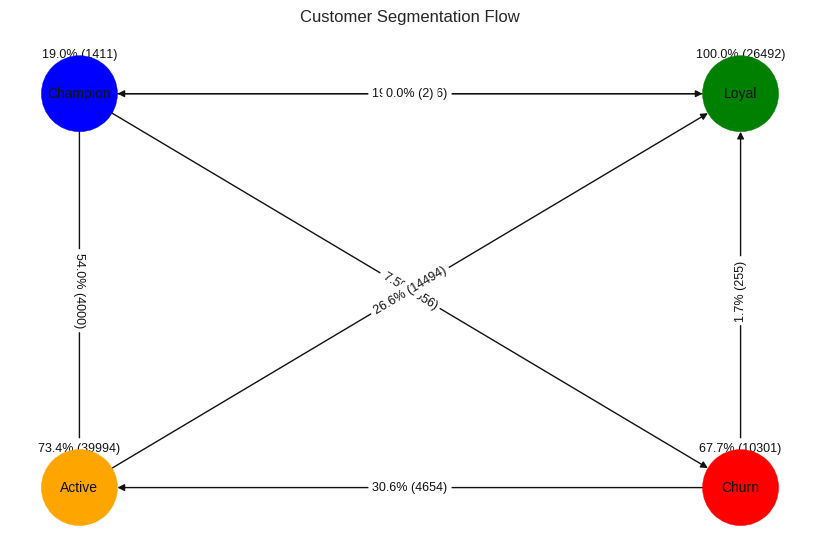

In [ ]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt

# ------------------------------------------------------
# Giả định rằng bạn đã có DataFrame df_rfmt và cluster_change_df với cấu trúc:
# df_rfmt:  ['customer_id','p_alive_pmcy','frequency','monetary_value','cluster_name']
# cluster_change_df: ['customer_id','p_alive_pmcy','frequency','monetary_value','cluster_52']
# ------------------------------------------------------

# 1) Tách dữ liệu Before / After
df_before = prepare_df[['customer_id', 'p_alive', 'frequency', 'monetary_value', 'cluster_name']].copy()
df_before.rename(columns={
    'p_alive': 'p_alive_before',
    'frequency': 'frequency_before',
    'monetary_value': 'monetary_before',
    'cluster_name': 'cluster_before'
}, inplace=True)

df_after = cluster_change_df[['customer_id', 'p_alive', 'frequency', 'monetary_value', 'cluster_new']].copy()
df_after.rename(columns={
    'p_alive': 'p_alive_after',
    'frequency': 'frequency_after',
    'monetary_value': 'monetary_after',
    'cluster_new': 'cluster_after'
}, inplace=True)

# 2) Gộp dữ liệu trước và sau theo customer_id
merged_df = pd.merge(df_before, df_after, on='customer_id', how='inner')

# 3) Tính bảng chuyển đổi (crosstab) giữa cụm ban đầu (cluster_before) và cụm sau (cluster_after)
transition_matrix = pd.crosstab(merged_df['cluster_before'], merged_df['cluster_after'], margins=True, margins_name="Total")
print("Bảng số lượng chuyển đổi:")
print(transition_matrix)

# 4) Tính phần trăm chuyển đổi theo hàng (mỗi hàng sẽ được chia theo tổng số khách hàng của cụm ban đầu)
# Lưu ý: Ta thực hiện phép chia theo hàng, trừ hàng "Total"
transition_percentage = transition_matrix.div(transition_matrix["Total"], axis=0) * 100
print("\nBảng phần trăm chuyển đổi:")
print(transition_percentage)

# 5) Xây dựng đồ thị mạng (Graph) sử dụng networkx

# Định nghĩa các nút (clusters) – bạn có thể điều chỉnh vị trí cho đẹp
nodes = {
    "Champion": (0, 1),
    "Loyal": (1, 1),
    "Active": (0, 0),
    "Churn": (1, 0)
}

# Khởi tạo đồ thị có hướng
G = nx.DiGraph()

# Thêm các nút vào đồ thị
for node, pos in nodes.items():
    G.add_node(node, pos=pos)

# Danh sách các cụm (loại trừ hàng/ cột Total)
clusters_list = [c for c in transition_matrix.index if c != "Total"]
dst_list = [c for c in transition_matrix.columns if c != "Total"]

# Thêm các cạnh (edge) vào đồ thị với nhãn là "x.x% (count)"
for src in clusters_list:
    for dst in dst_list:
        count = transition_matrix.loc[src, dst]
        if count > 0:
            percent = transition_percentage.loc[src, dst]
            # Chỉ định nhãn chuyển đổi
            label = f"{percent:.1f}% ({count})"
            G.add_edge(src, dst, label=label, weight=percent)

# 6) Vẽ đồ thị sử dụng matplotlib
plt.figure(figsize=(8, 5))
pos = nx.get_node_attributes(G, 'pos')

# Vẽ các nút
node_colors = {
    "Champion": "blue",
    "Loyal": "green",
    "Active": "orange",
    "Churn": "red"
}
colors = [node_colors.get(node, "gray") for node in G.nodes()]
nx.draw(G, pos, with_labels=True, node_color=colors, node_size=3000, font_size=10)

# Vẽ nhãn cho các cạnh
edge_labels = nx.get_edge_attributes(G, 'label')
nx.draw_networkx_edge_labels(G, pos, edge_labels=edge_labels, font_size=9)

plt.title("Customer Segmentation Flow")
plt.show()
